## Install

In [ ]:
pip install chart_studio


     |████████████████████████████████| 64 kB 2.3 MB/s 


In [ ]:
pip install plotly --upgrade

     |████████████████████████████████| 23.9 MB 73.6 MB/s 
  Attempting uninstall: plotly
    Found existing installation: plotly 4.4.1
    Uninstalling plotly-4.4.1:
      Successfully uninstalled plotly-4.4.1


In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import chart_studio.plotly as py
import chart_studio.tools as tls
import requests
import json
import os

In [ ]:
auth_file= open('/content/drive/MyDrive/Colab Notebooks/data/auth.txt')
auth_file = auth_file.read()
auth_file = auth_file.split(', ')
client_id = auth_file[0]
client_secret = auth_file[1]

In [ ]:
import chart_studio
username=client_id
api_key=client_secret
chart_studio.tools.set_credentials_file(username=username,
                                        api_key=api_key)

## Build data file

In [ ]:
df= pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/deces_2020.csv", sep=";", encoding="utf-8")

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (3,7) have mixed types.Specify dtype option on import or set low_memory=False.



In [ ]:
df["lieunaiss_str"]=df["lieunaiss"].astype("str")
df["lieunaiss_str"]=df["lieunaiss_str"].apply(lambda x: "0"+x if len(x)<5 else x)

In [ ]:
communes=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/commune2021.csv")

In [ ]:
communes_com=[x for x in communes["COM"]]
df.loc[df["lieunaiss_str"].isin(communes_com), "paysnaiss"] = "FRANCE"

In [ ]:
movement=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/mvtcommune2021.csv")

In [ ]:
movement_COM_AV=[x for x in movement["COM_AV"]]
df.loc[df["lieunaiss_str"].isin(movement_COM_AV), "paysnaiss"] = "FRANCE"

In [ ]:
for x in ["PALALDA", "LOMPNES", "HAUTEVILLE-LOMPNES"]:
  mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="FRANCE"

POLYNESIE=["ILES DU VENT", "ILES SOUS LES VENTS", "ARCHIPEL DES MARQUISES", "ARCHIPEL TUAMOTU", "ARCHIPEL TUBUAI", "PAPEETE" ,"TAPUTAPUATEA" ,"MOOREA-MAIAO" ,"TUMARAA" , \
           "PUNAAUIA","TEVA I UTA", "TAIARAPU-EST", "TAHAA", "TAIARAPU-OUEST","ARUE","TUBUAI", "UTUROA", "RAPA","FATU-HIVA", "BORA-BORA", "PIRAE", "HIVA-OA", "GAMBIER" , \
           "NUKU-HIVA" ,"UA-POU","HUAHINE","MAUPITI","NAPUKA","RURUTU", "FAAA","RANGIROA","ANAA","HIKUERU", "PAEA", "RAIVAVAE","HAO", "PAPARA", "TATAKOTO","MAKEMO", "FAKARAVA", \
           "TAKAROA", "RIMATARA", "HITIAA O TE RA", "TAHUATA","MAHINA","PUKAPUKA", "REAO", "FANGATAU", "UA-HUKA","MANIHI", "FANGATAU","ARUTUA","NUKUTAVAKE", "TUREIA"]
for x in POLYNESIE:
  mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="FRANCE(POLYNESIE)"

POLYNESIE_code=[str(x) for x in range(98711, 98759)]
for x in POLYNESIE_code:
  mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="FRANCE(POLYNESIE)"

CALEDONIE=["NOUVELLE CALEDONIE","TOUHO","THIO", "POYA", "POINDIMIE", "OUVEA", "NOUMEA","LE MONT-DORE", "KOUMAC","CANALA", "MARE","LIFOU", "HIENGHENE","PAITA", "DUMBEA", \
           "HOUAILOU"]
for x in CALEDONIE:
  mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="FRANCE(NOUVELLE_CALEDONIE)"

CALEDONIE_code=[str(x) for x in range(98801, 98834)]
for x in CALEDONIE_code:
  mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="FRANCE(NOUVELLE_CALEDONIE)"

MAYOTTE=["M'TSANGAMOUJI", "COLL TERR MAYOTTE", "KANI-KELI", "BANDRELE", "TSINGONI", "MAMOUDZOU", "SADA", "BOUENI" ,"CHIRONGUI", "CHICONI", "BANDRABOUA" ,"DZAOUDZI", \
          "PAMANDZI","ACOUA","MTSAMBORO","KOUNGOU", "OUANGANI","DEMBENI"]
for x in MAYOTTE:
  mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="FRANCE(MAYOTTE)"  

MAYOTTE_code=[str(x) for x in range(97601, 97618)]
for x in MAYOTTE_code:
  mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="FRANCE(MAYOTTE)"

WALIS=["ARCHIPEL WALLIS ET FUTUNA" , "ALO", "UVEA", "SIGAVE"]
for x in WALIS:
  mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="FRANCE(WALIS_FUTUNA)"  

REUNION=["REUNION"]
for x in REUNION:
  mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="FRANCE(REUNION)"  

SAINT_PIERRE=["SAINT-PIERRE", "MIQUELON-LANGLADE"]
for x in SAINT_PIERRE:
  mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="FRANCE(SAINT-PIERRE)"  

SAINT_MARTIN=["SAINT-MARTIN"]
for x in SAINT_MARTIN:
  mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="FRANCE(SAINT-MARTIN)"

SAINT_BARTHELEMY =["97701"]
for x in SAINT_BARTHELEMY:
  mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="FRANCE(SAINT-BARTHELEMY)"

Terres_australes=[str(x) for x in range(98411, 98416)]
for x in Terres_australes:
  mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="FRANCE(TERRES_AUSTRALES)"

ILE_DE_CLIPPERTON=["98901"]
for x in ILE_DE_CLIPPERTON:
  mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="FRANCE(ILE_DE_CLIPPERTON)"

ENGLAND=["99132"]
for x in ENGLAND:
  mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"{x}") 
  df.loc[mask,"paysnaiss" ]="ENGLAND"

mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"99101") 
df.loc[mask,"paysnaiss" ]="DANEMARK"

mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"99103") 
df.loc[mask,"paysnaiss" ]="NORWAY"

mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"99135") 
df.loc[mask,"paysnaiss" ]="NETHERLANDS"

mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"99223") 
df.loc[mask,"paysnaiss" ]="INDIA"

mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"99308") 
df.loc[mask,"paysnaiss" ]="ZANZIBAR"

mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"99313") 
df.loc[mask,"paysnaiss" ]="SPAIN"

mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"99404") 
df.loc[mask,"paysnaiss" ]="USA"

mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"99425") 
df.loc[mask,"paysnaiss" ]="ISLANDS"

mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"99427") 
df.loc[mask,"paysnaiss" ]="ENGLAND"

mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"99432") 
df.loc[mask,"paysnaiss" ]="USA"

mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"99501") 
df.loc[mask,"paysnaiss" ]="AUSTRALIA"

mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"99502") 
df.loc[mask,"paysnaiss" ]="NEW-ZEALAND"

mask=(df["paysnaiss"].isnull()==True)  & (df["lieunaiss_str"]==f"99505") 
df.loc[mask,"paysnaiss" ]="USA"

In [ ]:
for x in range (100):
  mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]==f"DEPARTEMENT {x:02d}") 
  df.loc[mask,"paysnaiss" ]="FRANCE"

In [ ]:
Algerie_francaise=["DEPARTEMENT D'ORAN", "DEPARTEMENT D'ALGER", "DEPARTEMENT DE CONSTANTINE", "SUD DE L'ALGERIE"]
for dep in Algerie_francaise:
  mask=((df["paysnaiss"].isnull()==True) & (df["commnaiss"]==dep))
  df.loc[mask, "paysnaiss"]="FRANCE(ALGERIE)"


mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="ANCIENNE GUINEE") 
df.loc[mask,"paysnaiss" ]="FRANCE(GUINEE)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="ANCIENNE COTE D'IVOIRE") 
df.loc[mask,"paysnaiss" ]="FRANCE(COTE D'IVOIRE)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="SOUDAN FRANCAIS") 
df.loc[mask,"paysnaiss" ]="FRANCE(SOUDAN)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="EX-DAHOMEY") 
df.loc[mask,"paysnaiss" ]="FRANCE(BENIN)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="TERR FRANCAIS AFARS ISSAS") 
df.loc[mask,"paysnaiss" ]="FRANCE(DJIBOUTI)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="MOYEN CONGO") 
df.loc[mask,"paysnaiss" ]="FRANCE(CONGO)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="ANCIEN GABON") 
df.loc[mask,"paysnaiss" ]="FRANCE(GABON)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="ANCIEN MADAGASCAR") 
df.loc[mask,"paysnaiss" ]="FRANCE(MADAGASCAR)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="ANCIEN SENEGAL") 
df.loc[mask,"paysnaiss" ]="FRANCE(SENEGAL)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="ANCIEN CAMEROUN") 
df.loc[mask,"paysnaiss" ]="FRANCE(CAMEROUN)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="OUBANGUI CHARI") 
df.loc[mask,"paysnaiss" ]="FRANCE(CENTRAFRIQUE)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="ANCIEN TOGO") 
df.loc[mask,"paysnaiss" ]="FRANCE(TOGO)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="ANCIEN TCHAD") 
df.loc[mask,"paysnaiss" ]="FRANCE(TCHAD)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="ANCIEN MAURITANIE") 
df.loc[mask,"paysnaiss" ]="FRANCE(MAURITANIE)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="ANCIEN NIGER") 
df.loc[mask,"paysnaiss" ]="FRANCE(NIGER)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="ANC CODOM FRANC-BRIT") 
df.loc[mask,"paysnaiss" ]="FRANCE(VANUATU)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="ANCIEN NIGER") 
df.loc[mask,"paysnaiss" ]="FRANCE(NIGER)"
mask=(df["paysnaiss"].isnull()==True)  & (df["commnaiss"]=="EX-HAUTE VOLTA") 
df.loc[mask,"paysnaiss" ]="FRANCE(BURKINA FASO)"

In [ ]:
pays=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/pays2021.csv")

In [ ]:
mask=df["paysnaiss"].isnull()==True
for s in df.loc[mask,"lieunaiss_str"]:
  if s in [x for x in pays["COG"] if pays[pays["COG"]==x].shape[0]<2]:
    mask_1=(df["paysnaiss"].isnull()==True) & (df["lieunaiss_str"]==s) 
    mask_2=pays["COG"]==s
    df.loc[mask_1, "paysnaiss"]=pays.loc[mask_2, "LIBCOG"].values[0]

In [ ]:
dict_value={k:v for k,v in zip(movement["COM_AV"], movement["COM_AP"])}
df["lieunaiss_str"]=df["lieunaiss_str"].apply(lambda x: dict_value[x] if x in dict_value.keys() else x)


## Updating old zip codes

In [ ]:
[s for s in [x for x in movement["COM_AV"]] if len(s.isin([x for x in movement["COM_AV"]])==True)>1    ]

AttributeError: ignored

In [ ]:
 "49105".count([x for x in movement["COM_AV"]])  

TypeError: ignored

In [ ]:
[x for x in [x for x in movement["COM_AV"]] if [x for x in movement["COM_AV"]].count(x)>1]

In [ ]:
Com_av=[x for x in movement["COM_AV"]]
retour=[]
for s in Com_av:
  if Com_av.count(s)>1:
    retour.append(s)

In [ ]:
len(retour)
len(Com_av)

13470

In [ ]:
Com_av.count("14463")

3

In [ ]:
movement[movement["COM_AV"]=="72116"]

,MOD,DATE_EFF,TYPECOM_AV,COM_AV,TNCC_AV,NCC_AV,NCCENR_AV,LIBELLE_AV,TYPECOM_AP,COM_AP,TNCC_AP,NCC_AP,NCCENR_AP,LIBELLE_AP
43,35,2020-09-25,COMD,72116,0,DISSE SOUS BALLON,Dissé-sous-Ballon,Dissé-sous-Ballon,COM,72189,0,MAROLLES LES BRAULTS,Marolles-les-Braults,Marolles-les-Braults
1271,32,2019-01-01,COM,72116,0,DISSE SOUS BALLON,Dissé-sous-Ballon,Dissé-sous-Ballon,COMD,72116,0,DISSE SOUS BALLON,Dissé-sous-Ballon,Dissé-sous-Ballon
1279,32,2019-01-01,COM,72116,0,DISSE SOUS BALLON,Dissé-sous-Ballon,Dissé-sous-Ballon,COM,72189,0,MAROLLES LES BRAULTS,Marolles-les-Braults,Marolles-les-Braults


In [ ]:
dict_value["72116"]

'72189'

In [ ]:
dict_value

{'16004': '16230',
 '16230': '16230',
 '16294': '16294',
 '16314': '16314',
 '16328': '16328',
 '16233': '16233',
 '16351': '16351',
 '27058': '27058',
 '27647': '27676',
 '27676': '27676',
 '50066': '50066',
 '50526': '50526',
 '53239': '53249',
 '53249': '53249',
 '53274': '53274',
 '56016': '56173',
 '56173': '56173',
 '73198': '73227',
 '73227': '73227',
 '14463': '14721',
 '14721': '14721',
 '27032': '27032',
 '27172': '27172',
 '27634': '27634',
 '27150': '27554',
 '27554': '27554',
 '27588': '27588',
 '22251': '22251',
 '22367': '22367',
 '05101': '05101',
 '05175': '05175',
 '72116': '72189',
 '72189': '72189',
 '74123': '74123',
 '74270': '74270',
 '35060': '35060',
 '35158': '35158',
 '56138': '56165',
 '56165': '56165',
 '52126': '52126',
 '52166': '52166',
 '79122': '79122',
 '79275': '79275',
 '28097': '28393',
 '28138': '28393',
 '28181': '28393',
 '28328': '28393',
 '28384': '28393',
 '28393': '28393',
 '73006': '73006',
 '28012': '28012',
 '28044': '28044',
 '28093': '2

In [ ]:
movement

,MOD,DATE_EFF,TYPECOM_AV,COM_AV,TNCC_AV,NCC_AV,NCCENR_AV,LIBELLE_AV,TYPECOM_AP,COM_AP,TNCC_AP,NCC_AP,NCCENR_AP,LIBELLE_AP
0,35,2021-01-01,COMD,16004,1,AIGNES ET PUYPEROUX,Aignes-et-Puypéroux,Aignes-et-Puypéroux,COM,16230,0,MONTMOREAU,Montmoreau,Montmoreau
1,35,2021-01-01,COM,16230,0,MONTMOREAU,Montmoreau,Montmoreau,COM,16230,0,MONTMOREAU,Montmoreau,Montmoreau
2,35,2021-01-01,COMD,16230,0,MONTMOREAU SAINT CYBARD,Montmoreau-Saint-Cybard,Montmoreau-Saint-Cybard,COM,16230,0,MONTMOREAU,Montmoreau,Montmoreau
3,35,2021-01-01,COMD,16294,0,SAINT AMANT DE MONTMOREAU,Saint-Amant-de-Montmoreau,Saint-Amant-de-Montmoreau,COM,16230,0,MONTMOREAU,Montmoreau,Montmoreau
4,35,2021-01-01,COMD,16314,0,SAINT EUTROPE,Saint-Eutrope,Saint-Eutrope,COM,16230,0,MONTMOREAU,Montmoreau,Montmoreau
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13465,31,1943-02-19,COM,60057,0,BEAUVAIS,Beauvais,Beauvais,COM,60057,0,BEAUVAIS,Beauvais,Beauvais
13466,31,1943-02-19,COM,60384,0,MARISSEL,Marissel,Marissel,COM,60057,0,BEAUVAIS,Beauvais,Beauvais
13467,31,1943-02-19,COM,60467,0,NOTRE DAME DU THIL,Notre-Dame-du-Thil,Notre-Dame-du-Thil,COM,60057,0,BEAUVAIS,Beauvais,Beauvais
13468,31,1943-02-19,COM,60580,0,SAINT JUST DES MARAIS,Saint-Just-des-Marais,Saint-Just-des-Marais,COM,60057,0,BEAUVAIS,Beauvais,Beauvais


In [ ]:
for s in Com_av:
  print(s)

In [ ]:
Com_av[0]
Com_av.count("16004")

3

In [ ]:
[x for x in movement["COM_AV"]].count("49105")

4

In [ ]:
df.shape[0]

679924

In [ ]:
fused_df.shape[0]

774433

In [ ]:
movement[movement["COM_AV"]=="20033"]

,MOD,DATE_EFF,TYPECOM_AV,COM_AV,TNCC_AV,NCC_AV,NCCENR_AV,LIBELLE_AV,TYPECOM_AP,COM_AP,TNCC_AP,NCC_AP,NCCENR_AP,LIBELLE_AP
7596,41,1976-01-01,COM,20033,0,BASTIA,Bastia,Bastia,COM,2B033,0,BASTIA,Bastia,Bastia


In [ ]:
movement[movement["COM_AP"]=="20033"]

,MOD,DATE_EFF,TYPECOM_AV,COM_AV,TNCC_AV,NCC_AV,NCCENR_AV,LIBELLE_AV,TYPECOM_AP,COM_AP,TNCC_AP,NCC_AP,NCCENR_AP,LIBELLE_AP


In [ ]:
x="20033"
movement[movement["COM_AV"]==x]["COM_AP"].values[0]

KeyError: ignored

In [ ]:
dict_value={k:v for k,v in zip(movement["COM_AV"], movement["COM_AP"])}

In [ ]:
def update_zip(x):
  movement_COM_AP=[x for x in movement["COM_AV"]]
  if x in movement_COM_AP:
    new_value=movement[movement["COM_AV"]==x]["COM_AP"].values[0]
    return new_value
  return x

In [ ]:
df

,nomprenom,sexe,datenaiss,lieunaiss,commnaiss,paysnaiss,datedeces,lieudeces,actedeces,lieunaiss_str
0,MUNET*ELISEE MARIE PIERRE/,1,19280925,49169,LA JUMELLIERE,FRANCE,20191216,01001,6,49169
1,GOURBIERE*MICHEL JOSEPH MARIUS/,1,19520222,42207,SAINT-CHAMOND,FRANCE,20200107,01004,6,42207
2,LEERS*RAYMONDE LOUISE/,2,19290412,69382,LYON 2E ARRONDISSEMENT,FRANCE,20200109,01004,8,69382
3,SIVIGNON*DANIELLE CLAUDE/,2,19390612,69382,LYON 2E ARRONDISSEMENT,FRANCE,20200116,01004,14,69382
4,LELYS*JOHNNY GABRIEL LUC/,1,19620219,79270,SAINT-MAIXENT-L'ECOLE,FRANCE,20200116,01004,15,79270
...,...,...,...,...,...,...,...,...,...,...
679919,FOURNIER*JEAN-LOUIS ANDRE ALBERT/,1,19570805,75118,PARIS 18E ARRONDISSEMENT,FRANCE,20200209,99134,2162,75118
679920,CHITOUR*KAMEL/,1,19410727,93352,DEPARTEMENT DE CONSTANTINE,FRANCE(ALGERIE),20200911,99134,2166,93352
679921,SCHOTTMULLER*WALTRAUD ROSINA/,2,19300218,99109,LAHR,ALLEMAGNE,20201111,99134,2165,99109
679922,MASSONNET*ANDRE CHARLES/,1,19431001,1060,BRENOD,FRANCE,20200929,99140,3588,01060


In [ ]:
missingzips

array(['37017', '37215', '37017', ..., '20349', '08108', '20265'],
      dtype=object)

In [ ]:
df[df["lieunaiss_str"]=="37017"]

,nomprenom,sexe,datenaiss,lieunaiss,commnaiss,paysnaiss,datedeces,lieudeces,actedeces,lieunaiss_str


In [ ]:
dict_value={k:v for k,v in zip(movement["COM_AV"], movement["COM_AP"])}
df["lieunaiss_str"]=df["lieunaiss_str"].apply(lambda x: dict_value[x] if x in dict_value.keys() else x)

In [ ]:
df["lieunaiss_str"].apply(lambda x: update_zip(x))

KeyboardInterrupt: ignored

In [ ]:
import timeit
df1=pd.DataFrame({"colA":["1", "2", "3"], "colB":["1", "2", "3"]})
df2=pd.DataFrame({"colA":["1", "7", "3"], "colB":["4", "5", "6"]})

In [ ]:
df1

,colA,colB
0,1,4
1,2,2
2,3,6


In [ ]:
# df1=pd.DataFrame({"colA":["1", "2", "3"], "colB":["1", "2", "3"]})
# df2=pd.DataFrame({"colA":["1", "7", "3"], "colB":["4", "5", "6"]})
df1=pd.DataFrame({"colA":[str(x) for x in range (100)], "colB":[str(x) for x in range (100)]})
df2=pd.DataFrame({"colA":[str(x) for x in np.random.randint(200, size=100)], "colB":[str(x) for x in range(100,200)] })
import time
def update_zip(x):
  values_available=[x for x in df2["colA"]]
  if x in values_available:
    new_value=df2[df2["colA"]==x]["colB"].values[0]
    return new_value
  return x
start = time.time()
df1["colB"]=df1["colB"].apply(lambda x: update_zip(x))
end = time.time()
print ("Took %f ms" % ((end - start) * 1000.0))

Took 18.442392 ms


In [ ]:
# df1=pd.DataFrame({"colA":["1", "2", "3"], "colB":["1", "2", "3"]})
# df2=pd.DataFrame({"colA":["1", "7", "3"], "colB":["4", "5", "6"]})
df1=pd.DataFrame({"colA":[str(x) for x in range (100)], "colB":[str(x) for x in range (100)]})
df2=pd.DataFrame({"colA":[str(x) for x in np.random.randint(200, size=100)], "colB":[str(x) for x in range(100,200)] })
start = time.time()
values_available=[x for x in df2["colA"]]
mask=(df1["colB"].isin(values_available))
missing_values=df1.loc[mask, "colB"].values
for s in missing_values:
  mask1=df2["colA"]==s
  mask2=df1["colB"]==s
  df1.loc[mask2,"colB"]=df2.loc[mask1, "colB"].values[0]
end = time.time()
print ("Took %f ms" % ((end - start) * 1000.0))

Took 32.885790 ms


In [ ]:
dict_value={k:v for k,v in zip(df2["colA"], df2["colB"])}
dict_value

{'1': '4', '3': '6', '7': '5'}

In [ ]:
[str(x) for x in range (100)]
[str(x) for x in range (100, 200)]
[str(x) for x in np.random.randint(200, size=100)]
[str(x) for x in np.random.randint(200, size=100)]
df1=pd.DataFrame({"colA":[str(x) for x in range (100)], "colB":[str(x) for x in range (100)]})
df2=pd.DataFrame({"colA":[str(x) for x in np.random.randint(200, size=100)], "colB":[str(x) for x in range(100,200)] })

In [ ]:
df1

,colA,colB
0,0,0
1,1,144
2,2,2
3,3,3
4,4,4
...,...,...
95,95,95
96,96,96
97,97,194
98,98,112


In [ ]:
# df1=pd.DataFrame({"colA":["1", "2", "3"], "colB":["1", "2", "3"]})
# df2=pd.DataFrame({"colA":["1", "7", "3"], "colB":["4", "5", "6"]})
%%time
df1=pd.DataFrame({"colA":[str(x) for x in range (100)], "colB":[str(x) for x in range (100)]})
df2=pd.DataFrame({"colA":[str(x) for x in np.random.randint(200, size=100)], "colB":[str(x) for x in range(100,200)] })
start = time.time()

dict_value={k:v for k,v in zip(df2["colA"], df2["colB"])}
df1["colB"]=df1["colB"].apply(lambda x: dict_value[x] if x in dict_value.keys() else x)
end = time.time()
print ("Took %f ms" % ((end - start) * 1000.0))


Took 1.121521 ms
CPU times: user 3.73 ms, sys: 0 ns, total: 3.73 ms
Wall time: 3.83 ms


In [ ]:
df1=pd.DataFrame({"colA":[str(x) for x in range (100)], "colB":[str(x) for x in range (100)]})
df2=pd.DataFrame({"colC":[str(x) for x in np.random.randint(200, size=100)], "colD":[str(x) for x in range(100,200)] })
df1=df1.merge(df2, how="left", left_on="colB", right_on="colC" )
df1

,colA,colB,colC,colD
0,0,0,NaN,NaN
1,1,1,NaN,NaN
2,2,2,2,129
3,3,3,3,163
4,4,4,NaN,NaN
...,...,...,...,...
104,95,95,95,150
105,96,96,96,169
106,97,97,NaN,NaN
107,98,98,98,101


In [ ]:
len(new_df["colB_x"].values)

108

In [ ]:
len([str(x) for x in range (0,200,2)])

100

In [ ]:
df1=pd.DataFrame({"colA":[str(x) for x in range (100)], "colB":[str(x) for x in range (100)]})
# df2=pd.DataFrame({"colA":[str(x) for x in np.random.randint(200, size=100)], "colB":[str(x) for x in range(100,200)] })
df2=pd.DataFrame({"colA":[str(x) for x in range (0,200,2)], "colB":[str(x) for x in range(100,200)] })
start = time.time()
new_df = df1.merge(df2, how = 'left', left_on='colB',right_on='colA')
new_df["colB_x"]=new_df["colB_x"].apply(lambda x: new_df["colB_y"].values[0] if new_df["colB_y"].values[0]!="NaN" else x)
end = time.time()
print ("Took %f ms" % ((end - start) * 1000.0))

Took 4.506111 ms


In [ ]:
movement_COM_AP=[x for x in movement["COM_AP"]]
mask=((~df["lieunaiss_str"].isin(movement_COM_AP)) & (~df["lieunaiss_str"].isin(communes_com)) &(df["paysnaiss"]=="FRANCE") & (df["lieunaiss_str"].isin(movement_COM_AV) ) )
missingzips=df.loc[mask, "lieunaiss_str"].values
# df[(~df["lieunaiss_str"].isin(movement_COM_AP)) & (~df["lieunaiss_str"].isin(communes_com)) &(df["paysnaiss"]=="FRANCE")]
# for s in df.loc[mask,"lieunaiss_str"]:
for s in missingzips:
  # missingzips=df.loc[mask, "lieunaiss_str"].values  
  # mask1=movement["COM_AV"].isin(missingzips)
  mask1=movement["COM_AV"]==s
  mask2=df["lieunaiss_str"]==s
  # print(s)
  df.loc[mask2,"lieunaiss_str"]=movement.loc[mask1, "COM_AP"].values[0]
  # print(s)

KeyboardInterrupt: ignored

In [ ]:
for s in  missingzips[:5]:
  print(s)

75041
78032
78515
75033
38196


In [ ]:
s="35213"
mask2=df["lieunaiss_str"]==s
mask1=movement["COM_AV"]==s
df.loc[mask2,"lieunaiss_str"]=movement.loc[mask1, "COM_AP"].values[0]

In [ ]:
df[df["lieunaiss_str"]=="35213"]

In [ ]:
df[df["paysnaiss"].isnull()==True]

## Creating age pyramid

In [ ]:
bins = pd.IntervalIndex.from_tuples([(0, 5), (5, 10), (10, 15), (15,20),(20,25), (25,30), (30,35), (35,40), (40,45), (45,50), (50, 55),(55, 60), (60,65), (65,70), (70,75), (75, 80), (80,85), (85, 90), (90, 95), (95,100), (105,110), (110,115) ])

In [ ]:
df["birthdate1"]=df["datenaiss"].astype("str")

In [ ]:
df["deathdate1"]=df["datedeces"].astype("str")

In [ ]:
df["birthdate1"]=df["birthdate1"].apply(lambda x: np.nan if "00" in x[-2:] or "00" in x[-4:-2] or "0000" in x[:-4] or x=="0" else x)

In [ ]:
df["deathdate1"]=df["deathdate1"].apply(lambda x: np.nan if "00" in x[-2:] or "00" in x[-4:-2] or "0000" in x[:-4] or x=="0" else x)

In [ ]:
df.dropna(inplace=True)

In [ ]:
df.drop(columns=["deathdate1", "birthdate1"], inplace=True)

In [ ]:
df["birthdate"]=pd.to_datetime(df["datenaiss"],  format='%Y%m%d')

In [ ]:
df["deathdate"]=pd.to_datetime(df["datedeces"],  format='%Y%m%d')

In [ ]:
df["lifespan"]=round((df["deathdate"]-df["birthdate"])/ np.timedelta64(1, 'Y'),2)

In [ ]:
df["nomprenomsplit"]=df["nomprenom"].apply(lambda x: x.split("*"))

In [ ]:
df["nom"]=df["nomprenomsplit"].apply(lambda x: x[0])

In [ ]:
df["prenom"]=df["nomprenomsplit"].apply(lambda x: x[1])

In [ ]:
df["prenom"]=df["prenom"].apply(lambda x: x.replace("/", ""))

In [ ]:
df['Range']=df.groupby("sexe", as_index=False)[["lifespan"]].transform(lambda x: pd.cut(x, bins) )

## Grouping data by sex


In [ ]:
data=df.groupby(["sexe", "Range"], as_index=False)[["lifespan"]].count().copy()

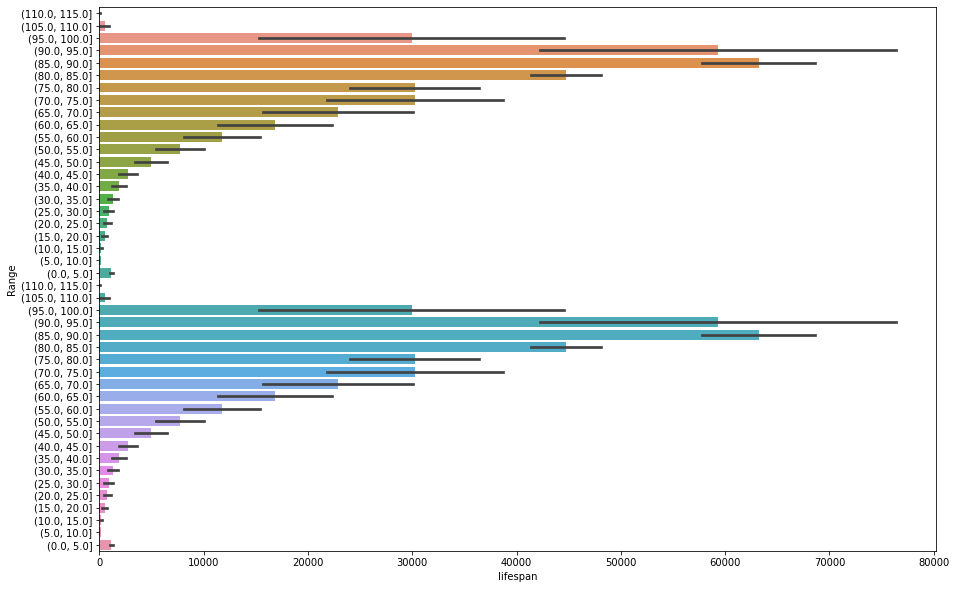

In [ ]:
plt.figure(figsize=(15,10))
bar_plot = sns.barplot(x='lifespan', y='Range', data=data,  order=data["Range"][::-1])

In [ ]:
data["lifespan"][22:]=data["lifespan"][22:].apply(lambda x: -x)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
data

,sexe,Range,lifespan
0,1,"(0.0, 5.0]",1304
1,1,"(5.0, 10.0]",180
2,1,"(10.0, 15.0]",229
3,1,"(15.0, 20.0]",732
4,1,"(20.0, 25.0]",1129
5,1,"(25.0, 30.0]",1336
6,1,"(30.0, 35.0]",1821
7,1,"(35.0, 40.0]",2516
8,1,"(40.0, 45.0]",3628
9,1,"(45.0, 50.0]",6475


Text(-50000, 20, 'Women')

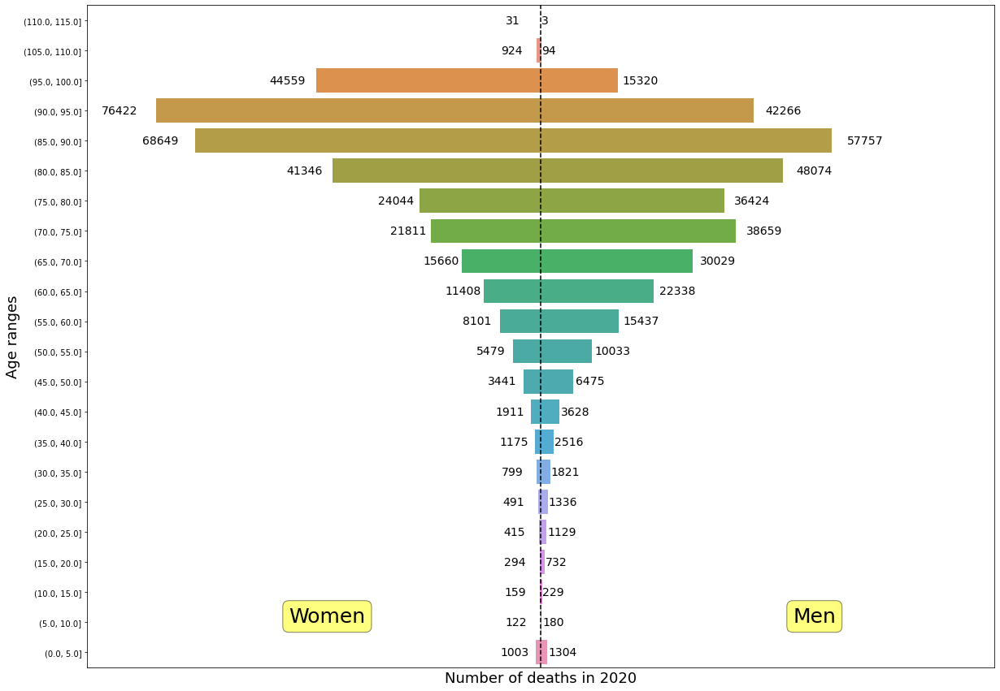

In [ ]:
plt.figure(figsize=(20,15))
plt.xlim((-90000, 90000))
plt.axvline(x=0, linestyle='--', color="black")

bar_plot = sns.barplot(x='lifespan', y='Range', data=data[22:],  order=data["Range"][21::-1])

for ytick in bar_plot.get_yticks():
    bar_plot.text(data["lifespan"][21-ytick] + 100+ data["lifespan"][21-ytick]* 0.05 ,ytick,  data["lifespan"][21-ytick], verticalalignment="center",  fontsize=14 )

bar_plot = sns.barplot(x='lifespan', y='Range', data=data[:22],  order=data["Range"][21::-1])
for ytick in bar_plot.get_yticks():
    bar_plot.text(data["lifespan"][43-ytick] -7000 + data["lifespan"][43-ytick]* 0.05, ytick,  -data["lifespan"][43-ytick], verticalalignment="center", ha="left", fontsize=14)  #, weight="semibold" )

bar_plot.tick_params( axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

bar_plot.set_xlabel(xlabel="Number of deaths in 2020",fontsize=18 )
bar_plot.set_ylabel(ylabel="Age ranges",fontsize=18 )

props = dict(boxstyle='round', facecolor='yellow', alpha=0.5)

bar_plot.text(50000, 20, "Men", fontsize=25,bbox=props )
bar_plot.text(-50000, 20, "Women", fontsize=25, bbox=props )

In [ ]:
df[df["prenom"]=="SOFIA"].sort_values("lifespan").head(50)

,nomprenom,sexe,datenaiss,lieunaiss,commnaiss,paysnaiss,datedeces,lieudeces,actedeces,lieunaiss_str,birthdate,deathdate,lifespan,nomprenomsplit,nom,prenom,Range
547347,BUTT*SOFIA/,2,20200506,99132,ROMFORD,ROYAUME-UNI,20200506,99132,4018,99132,2020-05-06,2020-05-06,0.00,"[BUTT, SOFIA/]",BUTT,SOFIA,NaN
452092,OUZAZA*SOFIA/,2,20200909,33063,BORDEAUX,FRANCE,20200914,33063,621,33063,2020-09-09,2020-09-14,0.01,"[OUZAZA, SOFIA/]",OUZAZA,SOFIA,"(0.0, 5.0]"
377330,BERREZIGUA*SOFIA/,2,20141029,93066,SAINT-DENIS,FRANCE,20200720,75115,2419,93066,2014-10-29,2020-07-20,5.72,"[BERREZIGUA, SOFIA/]",BERREZIGUA,SOFIA,"(5.0, 10.0]"
546953,OUCHIER*SOFIA/,2,20070605,78361,MANTES-LA-JOLIE,FRANCE,20200809,99350,76,78361,2007-06-05,2020-08-09,13.18,"[OUCHIER, SOFIA/]",OUCHIER,SOFIA,"(10.0, 15.0]"
19490,MANIULUA*SOFIA/,2,19660729,98611,ALO,FRANCE(WALIS_FUTUNA),20200110,35238,121,98611,1966-07-29,2020-01-10,53.45,"[MANIULUA, SOFIA/]",MANIULUA,SOFIA,"(50.0, 55.0]"
98167,EL MEJJATI*SOFIA/,2,19650820,99350,OUJDA,MAROC,20200121,72025,3,99350,1965-08-20,2020-01-21,54.42,"[EL MEJJATI, SOFIA/]",EL MEJJATI,SOFIA,"(50.0, 55.0]"
341051,KIMI*SOFIA/,2,19550913,98613,UVEA,FRANCE(WALIS_FUTUNA),20200229,98613,9,98613,1955-09-13,2020-02-29,64.46,"[KIMI, SOFIA/]",KIMI,SOFIA,"(60.0, 65.0]"
21680,DOS SANTOS PIEDADE*SOFIA/,2,19520217,99139,MOGOFORES,PORTUGAL,20191222,38543,20,99139,1952-02-17,2019-12-22,67.85,"[DOS SANTOS PIEDADE, SOFIA/]",DOS SANTOS PIEDADE,SOFIA,"(65.0, 70.0]"
437857,CASTRO LOPEZ*SOFIA/,2,19441129,99134,SAN JUAN DE FRIOLFE PARAMO,ESPAGNE,20200902,01173,69,99134,1944-11-29,2020-09-02,75.76,"[CASTRO LOPEZ, SOFIA/]",CASTRO LOPEZ,SOFIA,"(75.0, 80.0]"
213495,MUNOZ NAVARRO*SOFIA/,2,19420811,99134,CTAR,ESPAGNE,20200418,69006,26,99134,1942-08-11,2020-04-18,77.69,"[MUNOZ NAVARRO, SOFIA/]",MUNOZ NAVARRO,SOFIA,"(75.0, 80.0]"


In [ ]:
df[df["paysnaiss"]!="FRANCE"].sort_values("lifespan", ascending=False)

,nomprenom,sexe,datenaiss,lieunaiss,commnaiss,paysnaiss,datedeces,lieudeces,actedeces,lieunaiss_str,birthdate,deathdate,lifespan,nomprenomsplit,nom,prenom,Range
113479,OUSSENI*FEDA/,2,19081231,99397,KONI-NGANI-ANJOUAN,COMORES,20200201,97607,2,99397,1908-12-31,2020-02-01,111.09,"[OUSSENI, FEDA/]",OUSSENI,FEDA,"(110.0, 115.0]"
595567,AOUIZERATE*CAMILLE/,2,19091112,93352,DEPARTEMENT DE CONSTANTINE,FRANCE(ALGERIE),20201119,75112,1992,93352,1909-11-12,2020-11-19,111.02,"[AOUIZERATE, CAMILLE/]",AOUIZERATE,CAMILLE,"(110.0, 115.0]"
679063,RIDAI*SOUF/,1,19091231,99397,CHANDRA,COMORES,20201210,97610,61,99397,1909-12-31,2020-12-10,110.95,"[RIDAI, SOUF/]",RIDAI,SOUF,"(110.0, 115.0]"
652324,JEDRZEJCZYK*MARIANNE/,2,19100228,99122,OSTROWIEC,POLOGNE,20201218,62587,120,99122,1910-02-28,2020-12-18,110.81,"[JEDRZEJCZYK, MARIANNE/]",JEDRZEJCZYK,MARIANNE,"(110.0, 115.0]"
238759,HASSAN*ALLEGRINE/,2,19100213,99351,SFAX,TUNISIE,20200330,94068,174,99351,1910-02-13,2020-03-30,110.13,"[HASSAN, ALLEGRINE/]",HASSAN,ALLEGRINE,"(110.0, 115.0]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
341153,TAPUTU*HINAVAI OHANA TITAINA/,2,20200603,98736,PIRAE,FRANCE(POLYNESIE),20200603,98736,289,98736,2020-06-03,2020-06-03,0.00,"[TAPUTU, HINAVAI OHANA TITAINA/]",TAPUTU,HINAVAI OHANA TITAINA,NaN
389500,MAREA*OLIVIER IOANE/,1,20180104,98736,PIRAE,FRANCE(POLYNESIE),20180104,98736,7,98736,2018-01-04,2018-01-04,0.00,"[MAREA, OLIVIER IOANE/]",MAREA,OLIVIER IOANE,NaN
389756,ROLLIER*THEOPHILE JOSEPH MARIE/,1,20200625,99404,HOUSTON,ETATS-UNIS,20200625,99404,1397,99404,2020-06-25,2020-06-25,0.00,"[ROLLIER, THEOPHILE JOSEPH MARIE/]",ROLLIER,THEOPHILE JOSEPH MARIE,NaN
341169,SMITH*MERAHI/,2,20200512,98736,PIRAE,FRANCE(POLYNESIE),20200512,98736,257,98736,2020-05-12,2020-05-12,0.00,"[SMITH, MERAHI/]",SMITH,MERAHI,NaN


## grouping by sex and first name

In [ ]:
data4=df.groupby(['sexe',"prenom", "paysnaiss"], as_index=False)[["sexe", "prenom", "lifespan"]].agg(["mean", "std", "count"])
# data4.columns= data4.columns.get_level_values(1) 
# data4.columns= data4.columns.droplevel(0)
# data4 = data4.rename_axis(None, axis=1)
data4.columns = ['_'.join(col) for col in data4.columns]
# data4.reset_index()
data4["prenom"]=[data4.index[i][1] for i in range (data4.shape[0])]
data4["paysnaiss"]=[data4.index[i][2] for i in range (data4.shape[0])]
data4

sexe_mean  ...   paysnaiss
sexe prenom            paysnaiss              ...            
1                      ALGERIE             1  ...     ALGERIE
                       ANGOLA              1  ...      ANGOLA
                       BANGLADESH          1  ...  BANGLADESH
                       CAMBODGE            1  ...    CAMBODGE
                       CAMEROUN            1  ...    CAMEROUN
...                                      ...  ...         ...
2    ZUZANNA           FRANCE              2  ...      FRANCE
                       POLOGNE             2  ...     POLOGNE
     ZUZANNA DOLORES   POLOGNE             2  ...     POLOGNE
     ZUZANNA ZOFIA     ALLEMAGNE           2  ...   ALLEMAGNE
     ZYNIAK JACQUELINE FRANCE              2  ...      FRANCE

[310687 rows x 8 columns]

In [ ]:
# data4[data4["paysnaiss"]!="FRANCE"].sort_values(["lifespan_count", "lifespan_mean"] ,ascending=False).head(50)
data4[data4["paysnaiss"]!="FRANCE"].sort_values("lifespan_mean", ascending=False ).head(50)

sexe_mean  ...                       paysnaiss
sexe prenom                       paysnaiss                                  ...                                
2    FEDA                         COMORES                                 2  ...                         COMORES
1    SOUF                         COMORES                                 1  ...                         COMORES
2    ALLEGRINE                    TUNISIE                                 2  ...                         TUNISIE
     MONIQUE ROSALIE              BELGIQUE                                2  ...                        BELGIQUE
1    HIM                          CAMBODGE                                1  ...                        CAMBODGE
     FERNAND LUCIEN               CHINE                                   1  ...                           CHINE
2    HERMINE LEONARDINE           FRANCE(ALGERIE)                         2  ...                 FRANCE(ALGERIE)
     DESEMPARADOS                 ESPAGNE                                 2  ...                         ESPAGNE
     ELVIRA MARIA                 FRANCE(ALGERIE)                         2  ...                 FRANCE(ALGERIE)
     VICTORINE ADORA              ALGERIE                                 2  ...                         ALGERIE
     JACQUELINE ALENA ADZIRE      ROYAUME-UNI                             2  ...                     ROYAUME-UNI
     BERTHA MADELEINE             SUISSE                                  2  ...                          SUISSE
     PERLA                        ARGENTINE                               2  ...                       ARGENTINE
     BALTASARA                    ESPAGNE                                 2  ...                         ESPAGNE
     WLADYSLAWA MARIANNE          POLOGNE                                 2  ...                         POLOGNE
     MIREILLE EUGENIE             ALGERIE                                 2  ...                         ALGERIE
     LEJA                         LETTONIE                                2  ...                        LETTONIE
     AMANDINE SYLVIANNE ZACHARINE FRANCE(ALGERIE)                         2  ...                 FRANCE(ALGERIE)
     MAVIS MARGARET               ROYAUME-UNI                             2  ...                     ROYAUME-UNI
     JEANNE MARIE                 SUISSE                                  2  ...                          SUISSE
     CHASA FASGA                  POLOGNE                                 2  ...                         POLOGNE
     THEREZE                      ALLEMAGNE                               2  ...                       ALLEMAGNE
     HA                           CAMBODGE                                2  ...                        CAMBODGE
     GAEMILA                      ROUMANIE                                2  ...                        ROUMANIE
     MARIE ANTOINETTE             BELGIQUE                                2  ...                        BELGIQUE
     VERA                         ESTONIE                                 2  ...                         ESTONIE
     THERESIA FELICIA             BELGIQUE                                2  ...                        BELGIQUE
     KAETHE SOPHIE                ALLEMAGNE                               2  ...                       ALLEMAGNE
     ALBINE                       FRANCE(ALGERIE)                         2  ...                 FRANCE(ALGERIE)
     CHAYA                        LITUANIE                                2  ...                        LITUANIE
1    LUCIEN OCTAVE                TUNISIE                                 1  ...                         TUNISIE
2    LAETITIA LOUISE GERTRUDE     ALGERIE                                 2  ...                         ALGERIE
     JEANNE ANGELE                ITALIE                                  2  ...                          ITALIE
1    MOT                          VIET NAM                                1  ...                        VIET NA

In [ ]:
data5=data4.sort_values(["lifespan_count","lifespan_mean"], ascending=False).head(500)

In [ ]:
data5.sort_values(["lifespan_std", "lifespan_mean"])

sexe_mean  ...  paysnaiss
sexe prenom              paysnaiss             ...           
2    ODETTE MARIE LOUISE FRANCE             2  ...     FRANCE
     ODETTE JEANNE       FRANCE             2  ...     FRANCE
     MARGUERITE JEANNE   FRANCE             2  ...     FRANCE
     JEANNINE MARCELLE   FRANCE             2  ...     FRANCE
     JEANNE LOUISE       FRANCE             2  ...     FRANCE
...                                       ...  ...        ...
1    NICOLAS             FRANCE             1  ...     FRANCE
     MOHAMED             FRANCE             1  ...     FRANCE
     VICTOR              FRANCE             1  ...     FRANCE
     JULIEN              FRANCE             1  ...     FRANCE
     ALEXANDRE           FRANCE             1  ...     FRANCE

[500 rows x 8 columns]

In [ ]:
data5.index[0][2]

'FRANCE'

In [ ]:
data5["paysnaiss"]=[data5.index[i][2] for i in range (data5.shape[0])]

In [ ]:
data5["sexe_mean"]=data5["sexe_mean"].astype("str")

In [ ]:
# ,marker=dict( colorscale='Viridis') #error_x="lifespan_std",
px.scatter(data5, x="lifespan_mean", y="lifespan_count", log_y=True, color="sexe_mean",size="lifespan_count",  hover_data=[data5["prenom"]])

In [ ]:
px.scatter(data5[data5["paysnaiss"]!="FRANCE"], x="lifespan_mean", y="lifespan_count", log_y=True, color="sexe_mean",size="lifespan_count", hover_data=[data5[data5["paysnaiss"]!="FRANCE"]["prenom"]])

In [ ]:
px.scatter(data5, x="lifespan_mean", y="lifespan_count", log_y=True, size="lifespan_count",facet_col="sexe_mean", facet_row="paysnaiss",  hover_data=[data5["prenom"]])


In [ ]:
data5[data5["paysnaiss"]!="FRANCE"]

sexe_mean  ...        paysnaiss
sexe prenom     paysnaiss                  ...                 
1    MOHAMED    MAROC                   1  ...            MAROC
2    MARIA      ITALIE                  2  ...           ITALIE
1    MANUEL     PORTUGAL                1  ...         PORTUGAL
     ANTONIO    PORTUGAL                1  ...         PORTUGAL
     JOSE       PORTUGAL                1  ...         PORTUGAL
     MOHAMMED   ALGERIE                 1  ...          ALGERIE
     JOSE       ESPAGNE                 1  ...          ESPAGNE
     MOHAMED    ALGERIE                 1  ...          ALGERIE
     MOHAMMED   FRANCE(ALGERIE)         1  ...  FRANCE(ALGERIE)
     ABDELKADER ALGERIE                 1  ...          ALGERIE
2    MARIA      ESPAGNE                 2  ...          ESPAGNE
1    AHMED      ALGERIE                 1  ...          ALGERIE
                MAROC                   1  ...            MAROC
2    MARIA      PORTUGAL                2  ...         PORTUGAL
     FATMA      ALGERIE                 2  ...          ALGERIE
1    AHMED      FRANCE(ALGERIE)         1  ...  FRANCE(ALGERIE)
     MOHAMMED   MAROC                   1  ...            MAROC
     MOHAMED    TUNISIE                 1  ...          TUNISIE
     ANTONIO    ESPAGNE                 1  ...          ESPAGNE
     GIUSEPPE   ITALIE                  1  ...           ITALIE
2    FATIMA     ALGERIE                 2  ...          ALGERIE
1    MANUEL     ESPAGNE                 1  ...          ESPAGNE
     ANTONIO    ITALIE                  1  ...           ITALIE
     JOAQUIM    PORTUGAL                1  ...         PORTUGAL
2    FATIMA     MAROC                   2  ...            MAROC
1    ABDELKADER FRANCE(ALGERIE)         1  ...  FRANCE(ALGERIE)
2    CARMEN     ESPAGNE                 2  ...          ESPAGNE
1    ALI        ALGERIE                 1  ...          ALGERIE
2    YAMINA     ALGERIE                 2  ...          ALGERIE
1    FRANCISCO  ESPAGNE                 1  ...          ESPAGNE
2    AICHA      ALGERIE                 2  ...          ALGERIE
1    MOHAMED    FRANCE(ALGERIE)         1  ...  FRANCE(ALGERIE)
     MARIO      ITALIE                  1  ...           ITALIE
     SALVATORE  ITALIE                  1  ...           ITALIE
2    DOLORES    ESPAGNE                 2  ...          ESPAGNE
     JOSEFA     ESPAGNE                 2  ...          ESPAGNE
1    JOAO       PORTUGAL                1  ...         PORTUGAL
     GIOVANNI   ITALIE                  1  ...           ITALIE
     FRANCESCO  ITALIE                  1  ...           ITALIE
2    ANNA       ITALIE                  2  ...           ITALIE
1    ALI        FRANCE(ALGERIE)         1  ...  FRANCE(ALGERIE)
     SAID       ALGERIE                 1  ...          ALGERIE

[42 rows x 6 columns]

In [ ]:
data3=df.groupby(['sexe',"nom",  "paysnaiss"] , as_index=False)[["sexe", "nom", "lifespan"]].agg(["mean", "std", "count"])  #"paysnaiss", lieunaiss
data3.columns = ['_'.join(col) for col in data3.columns]
data3["nom"]=[data3.index[i][1] for i in range (data3.shape[0])]
data3["paysnaiss"]=[data3.index[i][2] for i in range (data3.shape[0])]
# data3["lieunaiss"]=[data3.index[i][2] for i in range (data3.shape[0])]
data3

sexe_mean  sexe_std  ...        nom  paysnaiss
sexe nom       paysnaiss                       ...                      
1              PORTUGAL           1       NaN  ...              PORTUGAL
     A MAKE    FRANCE             1       NaN  ...     A MAKE     FRANCE
     A SIM     FRANCE             1       NaN  ...      A SIM     FRANCE
     AA        FRANCE             1       0.0  ...         AA     FRANCE
     AABID     MAROC              1       NaN  ...      AABID      MAROC
...                             ...       ...  ...        ...        ...
2    ZYSKOWNA  FRANCE             2       NaN  ...   ZYSKOWNA     FRANCE
     ZYSMAN    FRANCE             2       NaN  ...     ZYSMAN     FRANCE
     ZYSSET    FRANCE             2       NaN  ...     ZYSSET     FRANCE
     ZYTKOWICZ POLOGNE            2       NaN  ...  ZYTKOWICZ    POLOGNE
     ZYWICA    POLOGNE            2       NaN  ...     ZYWICA    POLOGNE

[271645 rows x 8 columns]

In [ ]:
data2=data3.sort_values(["lifespan_count","lifespan_mean"], ascending=False).head(500)
data2["sexe_mean"]=data2["sexe_mean"].astype("str")

In [ ]:
data2.sort_values(["lifespan_std", "lifespan_mean"]).head(50)

sexe_mean  sexe_std  ...        nom  paysnaiss
sexe nom       paysnaiss                      ...                      
1    LACOMBE   FRANCE            1       0.0  ...    LACOMBE     FRANCE
2    LE GOFF   FRANCE            2       0.0  ...    LE GOFF     FRANCE
     MERLE     FRANCE            2       0.0  ...      MERLE     FRANCE
     BLANCHET  FRANCE            2       0.0  ...   BLANCHET     FRANCE
     BOUSQUET  FRANCE            2       0.0  ...   BOUSQUET     FRANCE
     LAUNAY    FRANCE            2       0.0  ...     LAUNAY     FRANCE
     PERRIER   FRANCE            2       0.0  ...    PERRIER     FRANCE
     HERVE     FRANCE            2       0.0  ...      HERVE     FRANCE
     BONNEAU   FRANCE            2       0.0  ...    BONNEAU     FRANCE
     GAY       FRANCE            2       0.0  ...        GAY     FRANCE
     LAINE     FRANCE            2       0.0  ...      LAINE     FRANCE
     DUPUY     FRANCE            2       0.0  ...      DUPUY     FRANCE
1    DIDIER    FRANCE            1       0.0  ...     DIDIER     FRANCE
2    MAURY     FRANCE            2       0.0  ...      MAURY     FRANCE
     GIRAUD    FRANCE            2       0.0  ...     GIRAUD     FRANCE
     LEGENDRE  FRANCE            2       0.0  ...   LEGENDRE     FRANCE
     TANGUY    FRANCE            2       0.0  ...     TANGUY     FRANCE
     COSTE     FRANCE            2       0.0  ...      COSTE     FRANCE
     GUYOT     FRANCE            2       0.0  ...      GUYOT     FRANCE
     COULON    FRANCE            2       0.0  ...     COULON     FRANCE
1    MARTY     FRANCE            1       0.0  ...      MARTY     FRANCE
2    NGUYEN    VIET NAM          2       0.0  ...     NGUYEN   VIET NAM
1    BESNARD   FRANCE            1       0.0  ...    BESNARD     FRANCE
2    PICHON    FRANCE            2       0.0  ...     PICHON     FRANCE
     CHAUVIN   FRANCE            2       0.0  ...    CHAUVIN     FRANCE
     FERRAND   FRANCE            2       0.0  ...    FERRAND     FRANCE
     NICOLAS   FRANCE            2       0.0  ...    NICOLAS     FRANCE
     OLLIVIER  FRANCE            2       0.0  ...   OLLIVIER     FRANCE
     DELAUNAY  FRANCE            2       0.0  ...   DELAUNAY     FRANCE
     ROY       FRANCE            2       0.0  ...        ROY     FRANCE
     GAUDIN    FRANCE            2       0.0  ...     GAUDIN     FRANCE
     MARTY     FRANCE            2       0.0  ...      MARTY     FRANCE
     MENARD    FRANCE            2       0.0  ...     MENARD     FRANCE
     BLANCHARD FRANCE            2       0.0  ...  BLANCHARD     FRANCE
     BRUN      FRANCE            2       0.0  ...       BRUN     FRANCE
     BIGOT     FRANCE            2       0.0  ...      BIGOT     FRANCE
     LEBLANC   FRANCE            2       0.0  ...    LEBLANC     FRANCE
     LEJEUNE   FRANCE            2       0.0  ...    LEJEUNE     FRANCE
     LAMY      FRANCE            2       0.0  ...       LAMY     FRANCE
     WEBER     FRANCE            2       0.0  ...      WEBER     FRANCE
     LENOIR    FRANCE            2       0.0  ...     LENOIR     FRANCE
     REY       FRANCE            2       0.0  ...        REY     FRANCE
     RENARD    FRANCE            2       0.0  ...     RENARD     FRANCE
     FABRE     FRANCE            2       0.0  ...      FABRE     FRANCE
     LACROIX   FRANCE            2       0.0  ...    LACROIX     FRANCE
     CLERC     FRANCE            2       0.0  ...      CLERC     FRANCE
     MARCHAND  FRANCE            2       0.0  ...   MARCHAND     FRANCE
1    DELMAS    FRANCE            1       0.0  ...     DELMAS     FRANCE
2    BRUNET    FRANCE            2       0.0  ...     BRUNET     FRANCE
     LAURENT   FRANCE            2       0.0  ...    LAURENT     FRANCE

[50 rows x 8 columns]

In [ ]:
px.scatter(data2, x="lifespan_mean", y="lifespan_count", log_y=True, color="sexe_mean",size="lifespan_count",  hover_data=[data2["nom"]])

In [ ]:
df[df["paysnaiss"]=="FRANCE"].sort_values("lieunaiss_str", ascending=False).head(50)

In [ ]:
df[df["lieunaiss"]=="2B033"]

In [ ]:
df.sort_values("lieunaiss_str", ascending=False)


In [ ]:

data1=df[df["paysnaiss"]=="FRANCE"].groupby(['sexe', "lieunaiss","commnaiss"] , as_index=False)[["sexe", "lifespan"]].agg(["mean", "std", "count"])  #"paysnaiss", lieunaiss
data1.columns = ['_'.join(col) for col in data1.columns]
# data1["nom"]=[data3.index[i][1] for i in range (data3.shape[0])]
# data3["paysnaiss"]=[data3.index[i][2] for i in range (data3.shape[0])]
data1["lieunaiss"]=[data1.index[i][1] for i in range (data1.shape[0])]
data1["commnaiss"]=[data1.index[i][2] for i in range (data1.shape[0])]
data1

sexe_mean  ...            commnaiss
sexe lieunaiss commnaiss                       ...                     
1    1004      AMBERIEU-EN-BUGEY            1  ...    AMBERIEU-EN-BUGEY
     1005      AMBERIEUX-EN-DOMBES          1  ...  AMBERIEUX-EN-DOMBES
     1020      ARNANS                       1  ...               ARNANS
     1021      ARS-SUR-FORMANS              1  ...      ARS-SUR-FORMANS
     1033      VALSERHONE                   1  ...           VALSERHONE
...                                       ...  ...                  ...
2    97611     MAMOUDZOU                    2  ...            MAMOUDZOU
     97612     MTSAMBORO                    2  ...            MTSAMBORO
     97613     M'TSANGAMOUJI                2  ...        M'TSANGAMOUJI
     97614     OUANGANI                     2  ...             OUANGANI
     97617     TSINGONI                     2  ...             TSINGONI

[69459 rows x 8 columns]

In [ ]:
data6=data1.sort_values(["lifespan_count","lifespan_mean"], ascending=False).head(500)
# data6.sort_values(["lifespan_std", "lifespan_mean"]).head(50)

In [ ]:
cities=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/cities.csv")
cities["zip_code"].fillna(0, inplace=True)
cities["zip_code"]=cities["zip_code"].apply(lambda x: int(x) )
cities["zip_code_str"]=cities["zip_code"].astype("str")
cities["zip_code_str"]=cities["zip_code_str"].apply(lambda x: "0"+x if len(x)<5 else x)
cities

,id,department_code,insee_code,zip_code,name,slug,gps_lat,gps_lng,zip_code_str
0,1,01,01001,1400,L'Abergement-Clémenciat,l abergement clemenciat,46.156782,4.924699,01400
1,2,01,01002,1640,L'Abergement-de-Varey,l abergement de varey,46.010086,5.428759,01640
2,3,01,01004,1500,Ambérieu-en-Bugey,amberieu en bugey,45.958409,5.375992,01500
3,4,01,01005,1330,Ambérieux-en-Dombes,amberieux en dombes,46.000120,4.910602,01330
4,5,01,01006,1300,Ambléon,ambleon,45.746427,5.602492,01300
...,...,...,...,...,...,...,...,...,...
35848,35849,988,NaN,98831,Touho,touho,-20.780538,165.232815,98831
35849,35850,988,NaN,98833,Voh,voh,-20.949963,164.687186,98833
35850,35851,988,NaN,98834,Yaté,yate,-22.159370,166.944270,98834
35851,35852,988,NaN,98818,Kouaoua,kouaoua,-21.396181,165.828447,98818


In [ ]:
data6["gps_lat"]="NaN"
data6["gps_lng"]="NaN"

data6

sexe_mean  sexe_std  ...  gps_lat  gps_lng
sexe lieunaiss commnaiss                                       ...                  
2    75114     PARIS 14E  ARRONDISSEMENT          2       0.0  ...      NaN      NaN
1    13055     MARSEILLE                          1       0.0  ...      NaN      NaN
2    13055     MARSEILLE                          2       0.0  ...      NaN      NaN
1    75114     PARIS 14E  ARRONDISSEMENT          1       0.0  ...      NaN      NaN
     59350     LILLE                              1       0.0  ...      NaN      NaN
...                                             ...       ...  ...      ...      ...
     57491     MOYEUVRE-GRANDE                    1       0.0  ...      NaN      NaN
     38196     JALLIEU                            1       0.0  ...      NaN      NaN
     83069     HYERES                             1       0.0  ...      NaN      NaN
     75069     SAINT-MAURICE                      1       0.0  ...      NaN      NaN
     78428     MONTMORENCY                        1       0.0  ...      NaN      NaN

[500 rows x 10 columns]

In [ ]:
address=set([x for x in data6["commnaiss"]])

for s in address:
  url=f'https://nominatim.openstreetmap.org/search.php?q=FRANCE+{"+".join([x for x in s.split()])}+&format=jsonv2'
  response=requests.get(url).json()
  # response
  mask=(data6["commnaiss"]==s)
  data6.loc[mask, "gps_lat"]=response[0]["lat"]
  data6.loc[mask, "gps_lng"]=response[0]["lon"]
  # print(response[0]["lat"],response[0]["lon"])

In [ ]:
data6.info()

In [ ]:
data6.sort_values("lifespan_mean").head(50)

In [ ]:
px.density_mapbox(data6, lat='gps_lat', lon='gps_lng', z='lifespan_mean', radius=10,
                        center=dict(lat=46.2276, lon=2.2137), zoom=0,
                        mapbox_style="stamen-terrain")



In [ ]:
df[df["paysnaiss"]=="FRANCE"]

,nomprenom,sexe,datenaiss,lieunaiss,commnaiss,paysnaiss,datedeces,lieudeces,actedeces,lieunaiss_str,birthdate,deathdate,lifespan,nomprenomsplit,nom,prenom,Range
0,MUNET*ELISEE MARIE PIERRE/,1,19280925,49169,LA JUMELLIERE,FRANCE,20191216,01001,6,49169,1928-09-25,2019-12-16,91.22,"[MUNET, ELISEE MARIE PIERRE/]",MUNET,ELISEE MARIE PIERRE,"(90.0, 95.0]"
1,GOURBIERE*MICHEL JOSEPH MARIUS/,1,19520222,42207,SAINT-CHAMOND,FRANCE,20200107,01004,6,42207,1952-02-22,2020-01-07,67.88,"[GOURBIERE, MICHEL JOSEPH MARIUS/]",GOURBIERE,MICHEL JOSEPH MARIUS,"(65.0, 70.0]"
2,LEERS*RAYMONDE LOUISE/,2,19290412,69382,LYON 2E ARRONDISSEMENT,FRANCE,20200109,01004,8,69382,1929-04-12,2020-01-09,90.75,"[LEERS, RAYMONDE LOUISE/]",LEERS,RAYMONDE LOUISE,"(90.0, 95.0]"
3,SIVIGNON*DANIELLE CLAUDE/,2,19390612,69382,LYON 2E ARRONDISSEMENT,FRANCE,20200116,01004,14,69382,1939-06-12,2020-01-16,80.60,"[SIVIGNON, DANIELLE CLAUDE/]",SIVIGNON,DANIELLE CLAUDE,"(80.0, 85.0]"
4,LELYS*JOHNNY GABRIEL LUC/,1,19620219,79270,SAINT-MAIXENT-L'ECOLE,FRANCE,20200116,01004,15,79270,1962-02-19,2020-01-16,57.91,"[LELYS, JOHNNY GABRIEL LUC/]",LELYS,JOHNNY GABRIEL LUC,"(55.0, 60.0]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
679917,ETCHEVARNE*RACHEL DOMINIQUE LOLITA/,2,19651204,55029,BAR-LE-DUC,FRANCE,20201030,99341,1472,55029,1965-12-04,2020-10-30,54.91,"[ETCHEVARNE, RACHEL DOMINIQUE LOLITA/]",ETCHEVARNE,RACHEL DOMINIQUE LOLITA,"(50.0, 55.0]"
679918,PAIXAO*ALEX GUILLAUME RUIVO/,1,19831219,92064,SAINT-CLOUD,FRANCE,20180720,99134,2163,92064,1983-12-19,2018-07-20,34.59,"[PAIXAO, ALEX GUILLAUME RUIVO/]",PAIXAO,ALEX GUILLAUME RUIVO,"(30.0, 35.0]"
679919,FOURNIER*JEAN-LOUIS ANDRE ALBERT/,1,19570805,75118,PARIS 18E ARRONDISSEMENT,FRANCE,20200209,99134,2162,75118,1957-08-05,2020-02-09,62.51,"[FOURNIER, JEAN-LOUIS ANDRE ALBERT/]",FOURNIER,JEAN-LOUIS ANDRE ALBERT,"(60.0, 65.0]"
679922,MASSONNET*ANDRE CHARLES/,1,19431001,1060,BRENOD,FRANCE,20200929,99140,3588,01060,1943-10-01,2020-09-29,77.00,"[MASSONNET, ANDRE CHARLES/]",MASSONNET,ANDRE CHARLES,"(75.0, 80.0]"


In [ ]:
df_canton=df[(df["paysnaiss"]=="FRANCE")& (df["Canton"]!="NaN") & (df["Canton"].isnull()!=True)].copy()

In [ ]:
df_canton.to_csv("/content/drive/MyDrive/Colab Notebooks/data/df_canton.csv")

In [ ]:
df_canton=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/df_canton.csv")

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (4,8,10,18) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [ ]:
df_canton

,Unnamed: 0,nomprenom,sexe,datenaiss,lieunaiss,commnaiss,paysnaiss,datedeces,lieudeces,actedeces,lieunaiss_str,birthdate,deathdate,lifespan,nomprenomsplit,nom,prenom,Range,Canton
0,1,GOURBIERE*MICHEL JOSEPH MARIUS/,1,19520222,42207,SAINT-CHAMOND,FRANCE,20200107,01004,6,42207,1952-02-22,2020-01-07,67.88,"['GOURBIERE', 'MICHEL JOSEPH MARIUS/']",GOURBIERE,MICHEL JOSEPH MARIUS,"(65.0, 70.0]",4213
1,4,LELYS*JOHNNY GABRIEL LUC/,1,19620219,79270,SAINT-MAIXENT-L'ECOLE,FRANCE,20200116,01004,15,79270,1962-02-19,2020-01-16,57.91,"['LELYS', 'JOHNNY GABRIEL LUC/']",LELYS,JOHNNY GABRIEL LUC,"(55.0, 60.0]",7915
2,5,VAUDET*COLETTE CHRISTIANE/,2,19320721,01384,SAINT-RAMBERT-EN-BUGEY,FRANCE,20200110,01004,9,01384,1932-07-21,2020-01-10,87.47,"['VAUDET', 'COLETTE CHRISTIANE/']",VAUDET,COLETTE CHRISTIANE,"(85.0, 90.0]",0101
3,8,AMBROSI*MICHELLE HELENE/,2,19380326,01304,PONT-D'AIN,FRANCE,20200124,01004,19,01304,1938-03-26,2020-01-24,81.83,"['AMBROSI', 'MICHELLE HELENE/']",AMBROSI,MICHELLE HELENE,"(80.0, 85.0]",0116
4,10,GRINAND*MARCELLE EUGENIE/,2,19270426,01004,AMBERIEU-EN-BUGEY,FRANCE,20200105,01004,5,01004,1927-04-26,2020-01-05,92.70,"['GRINAND', 'MARCELLE EUGENIE/']",GRINAND,MARCELLE EUGENIE,"(90.0, 95.0]",0101
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
477379,679912,BOUVART*GUILLAUME ALEXANDRE/,1,19890319,97415,SAINT-PAUL,FRANCE,20201021,99501,1121,97415,1989-03-19,2020-10-21,31.59,"['BOUVART', 'GUILLAUME ALEXANDRE/']",BOUVART,GUILLAUME ALEXANDRE,"(30.0, 35.0]",97497
477380,679913,LEPORE*LAURENT/,1,19671226,19031,BRIVE-LA-GAILLARDE,FRANCE,20201127,99326,1277,19031,1967-12-26,2020-11-27,52.92,"['LEPORE', 'LAURENT/']",LEPORE,LAURENT,"(50.0, 55.0]",1999
477381,679917,ETCHEVARNE*RACHEL DOMINIQUE LOLITA/,2,19651204,55029,BAR-LE-DUC,FRANCE,20201030,99341,1472,55029,1965-12-04,2020-10-30,54.91,"['ETCHEVARNE', 'RACHEL DOMINIQUE LOLITA/']",ETCHEVARNE,RACHEL DOMINIQUE LOLITA,"(50.0, 55.0]",5598
477382,679918,PAIXAO*ALEX GUILLAUME RUIVO/,1,19831219,92064,SAINT-CLOUD,FRANCE,20180720,99134,2163,92064,1983-12-19,2018-07-20,34.59,"['PAIXAO', 'ALEX GUILLAUME RUIVO/']",PAIXAO,ALEX GUILLAUME RUIVO,"(30.0, 35.0]",9223


In [ ]:
df_canton_group=df_canton.groupby(['sexe', "Canton"] , as_index=False)[["sexe", "lifespan"]].agg(["mean", "std", "count"]) 
df_canton_group.columns = ['_'.join(col) for col in df_canton_group.columns]
# data1["nom"]=[data3.index[i][1] for i in range (data3.shape[0])]
# data3["paysnaiss"]=[data3.index[i][2] for i in range (data3.shape[0])]
df_canton_group["Canton_col"]=[df_canton_group.index[i][1] for i in range (df_canton_group.shape[0])]

NameError: ignored

In [ ]:
df_canton_group.sort_values("sexe_count", ascending=False)

sexe_mean  sexe_std  ...  lifespan_count  Canton_col
sexe Canton                       ...                            
1    1398            1       0.0  ...            4120        1398
2    1398            2       0.0  ...            3951        1398
1    5997            1       0.0  ...            1904        5997
     4496            1       0.0  ...            1762        4496
2    6799            2       0.0  ...            1761        6799
...                ...       ...  ...             ...         ...
     4915            2       NaN  ...               1        4915
1    4208            1       NaN  ...               1        4208
2    4918            2       NaN  ...               1        4918
1    4206            1       NaN  ...               1        4206
     2A09            1       NaN  ...               1        2A09

[7011 rows x 7 columns]

In [ ]:
df_canton_group[df_canton_group["Canton_col"].str.contains("1001")]

ValueError: ignored

In [ ]:
df[(df["paysnaiss"]=="FRANCE") & (df["commnaiss"].str.contains("PARIS"))]

## chloro maps


In [ ]:
df_canton_group=df[df["paysnaiss"]=="FRANCE"].groupby(["lieunaiss_str"] , as_index=False)[["lifespan"]].agg(["mean", "std", "count"]) 
df_canton_group.columns = ['_'.join(col) for col in df_canton_group.columns]
# data1["nom"]=[data3.index[i][1] for i in range (data3.shape[0])]
# data3["paysnaiss"]=[data3.index[i][2] for i in range (data3.shape[0])]
df_canton_group["lieunaiss_str_col"]=[df_canton_group.index[i] for i in range (df_canton_group.shape[0])]

df_canton_group.reset_index(inplace=True)

In [ ]:
df_canton_group.to_csv("/content/drive/MyDrive/Colab Notebooks/data/deces_2020_reformatted.csv")

In [ ]:
df_canton_group=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/deces_2020_reformatted.csv")

In [ ]:
from urllib.request import urlopen
import json
with urlopen("https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/communes-version-simplifiee.geojson") as response:
    counties = json.load(response)
for items in counties["features"]:
  if not items["geometry"]:
    # print("test")
    items["geometry"]= {'type': 'Polygon', "coordinates":[[[1,1],[1,1], [1,1]]]} 

# test=pd.read_json("/content/drive/MyDrive/Colab Notebooks/data/arrondissements.geojson.txt")

In [ ]:
# from urllib.request import urlopen
# import json
# with urlopen("/content/drive/MyDrive/Colab Notebooks/data/test.json") as response:
with open("/content/drive/MyDrive/Colab Notebooks/data/test2.json") as json_file:
  paris = json.load(json_file)
for items in paris["features"]:
  if not items["geometry"]:
    # print("test")
    items["geometry"]= {'type': 'Polygon', "coordinates":[[[1,1],[1,1], [1,1]]]} 

In [ ]:
with open("/content/drive/MyDrive/Colab Notebooks/data/commune_simp1.json") as json_file:
  commu = json.load(json_file)
for items in commu["features"]:
  items["properties"].pop("SIREN_EPCI", None)
  items["properties"].pop("RECENSEUR", None)
  items["properties"].pop("ID_AUT_ADM", None)
  items["properties"].pop("DATE_RCT", None)
  items["properties"].pop("CAPITALE", None)
  items["properties"].pop("CL_REGION", None)
  items["properties"].pop("CL_DEPART", None)
  items["properties"].pop("CL_COLLTER", None)
  items["properties"].pop("CL_ARROND", None)
  items["properties"].pop("DATE_CONF", None)  
  items["properties"].pop("DATE_APP", None)
  items["properties"].pop("DATE_MAJ", None)  
  items["properties"].pop("DATE_CREAT", None)
  items["properties"].pop("ID", None)  
  items["properties"].pop("CODE_SIREN", None)
  items["properties"].pop("ID", None)  
  items["properties"].pop("ID_CH_LIEU", None)

  if not items["geometry"]:  
      items["geometry"]= {'type': 'Polygon', "coordinates":[[[1,1],[1,1], [1,1]]]} 


In [ ]:
with open('/content/drive/MyDrive/Colab Notebooks/data/data.json', 'w') as f:
    json.dump(commu, f)

In [ ]:
with open("/content/drive/MyDrive/Colab Notebooks/data/data.json") as json_file:
  commu = json.load(json_file)

In [ ]:
with open("/content/drive/MyDrive/Colab Notebooks/data/arrondissement_simp.json") as json_file:
  arron = json.load(json_file)
for items in arron["features"]:
    items["properties"].pop("DATE_CREAT", None)
    items["properties"].pop("ID", None)
    items["properties"].pop("DATE_MAJ", None)
    items["properties"].pop("DATE_CONF", None)
    items["properties"].pop("DATE_APP", None)
    items["properties"].pop("ID_AUT_ADM", None)
    items["properties"].pop("ID_CH_LIEU", None)
    items["properties"]["INSEE_COM"]=items["properties"]["INSEE_ARM"]
#   if not items["geometry"]:  
#       items["geometry"]= {'type': 'Polygon', "coordinates":[[[1,1],[1,1], [1,1]]]} 

In [ ]:
commu["features"].extend(arron["features"])

In [ ]:
for items in paris["features"]:
  if not items["geometry"]:
    print("test")

In [ ]:
df_canton_group[df_canton_group["lieunaiss_str_col"]=="69123"]

,lieunaiss_str,lifespan_mean,lifespan_std,lifespan_count,lieunaiss_str_col


In [ ]:
for i in range (10):
  print(i, counties["features"][i]["geometry"])

In [ ]:
arron["features"][0]["properties"]["INSEE_COM"]

'69123'

In [ ]:
len(arron["features"])

99

In [ ]:
for i in range (99):
  # print(i, arron["features"][i]["properties"])
  arron["features"][i]["properties"]["INSEE_COM"]=arron["features"][i]["properties"]["INSEE_ARM"]


In [ ]:
for i in range (10):
  print(i, commu["features"][i]["properties"])

In [ ]:
for i in range (10):
  print(i, commu["features"][i]["geometry"])

In [ ]:
fig=px.choropleth_mapbox(df_canton_group, geojson=arron, locations=df_canton_group.lieunaiss_str_col, featureidkey="properties.INSEE_ARM", color=df_canton_group.lifespan_mean,
                           color_continuous_scale="Viridis",
                           range_color=(55, 100),
                           mapbox_style="carto-positron",
                           center=dict(lat=46.2276, lon=2.2137), zoom=3,
                           opacity=0.5                    
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
fig=px.choropleth_mapbox(df_canton_group, geojson=commu, locations="lieunaiss_str_col", featureidkey="properties.INSEE_COM", color="lifespan_mean",
                           color_continuous_scale="Viridis",
                           range_color=(55, 100),
                           mapbox_style="carto-positron",
                           center=dict(lat=46.2276, lon=2.2137), zoom=3,
                           opacity=0.5                    
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
# py.plot(fig, filename="deces_choropleth", auto_open = True)
fig.write_html("/content/drive/MyDrive/Colab Notebooks/data/choropleth.html")

In [ ]:
# cities_zip_codes=[x for x in cities["zip_code_str"]]
for s in [x for x in data6.lieunaiss]:
  print(s)
  mask_1=(data6["lieunaiss"]==s) 
  mask_2=(cities["zip_code_str"]==s)
  # data6.loc[mask_1, "gps_lng"] = cities.loc[mask_2, "gps_lng"].values[0]
  print(cities.loc[mask_2, "gps_lng"].values[0])
# data6["gps_lng"]=["NaN"*data6.shape[0]]

# api for lat lon

In [ ]:
address='FRANCE MACON'

url=f'https://nominatim.openstreetmap.org/search.php?q={"+".join([x for x in address.split()])}+&format=jsonv2'
response=requests.get(url).json()
response
print(response[0]["lat"],response[0]["lon"])

46.3036683 4.8322266


In [ ]:
s="75009"
mask_2=(cities["zip_code_str"]==s)
cities.loc[mask_2, "gps_lng"].values[0]

2.3379062999999998

In [ ]:
cities[cities["zip_code_str"]=="99352"]

,id,department_code,insee_code,zip_code,name,slug,gps_lat,gps_lng,zip_code_str


In [ ]:
mask=df["paysnaiss"].isnull()==True
for s in df.loc[mask,"lieunaiss_str"]:
  if s in [x for x in pays["COG"] if pays[pays["COG"]==x].shape[0]<2]:
    mask_1=(df["paysnaiss"].isnull()==True) & (df["lieunaiss_str"]==s) 
    mask_2=pays["COG"]==s
    df.loc[mask_1, "paysnaiss"]=pays.loc[mask_2, "LIBCOG"].values[0]

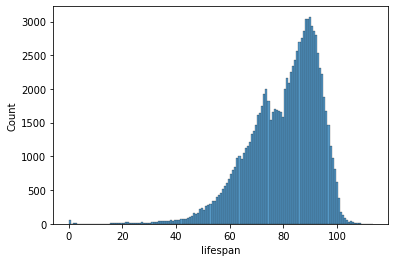

In [ ]:
sns.histplot(data=df[df["prenom"].str.contains("JEAN")], x="lifespan")

JEAN


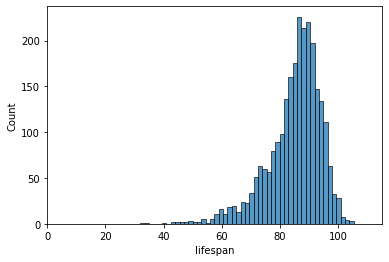

MICHEL


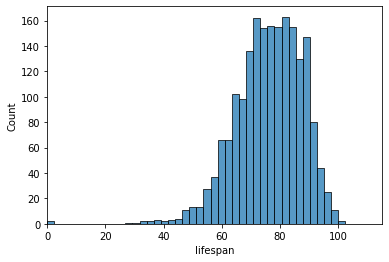

MARIE THERESE


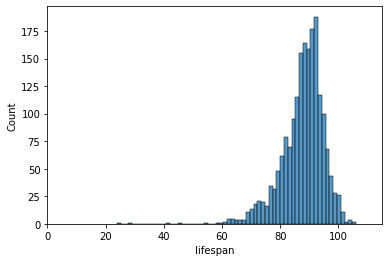

ANDRE


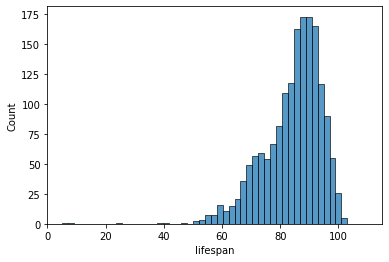

PIERRE


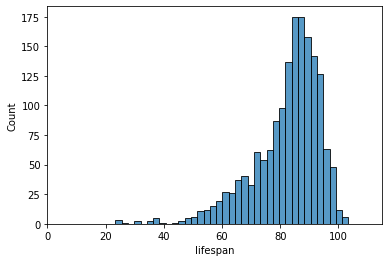

MARIE


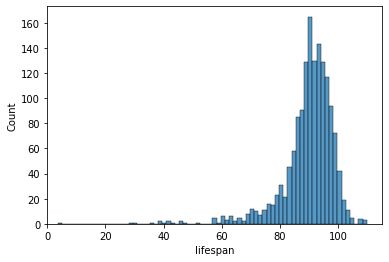

MARIE LOUISE


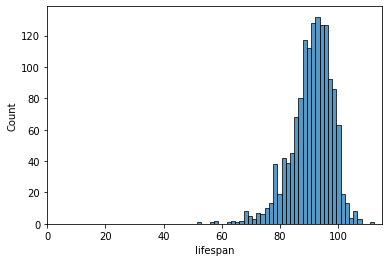

JACQUELINE


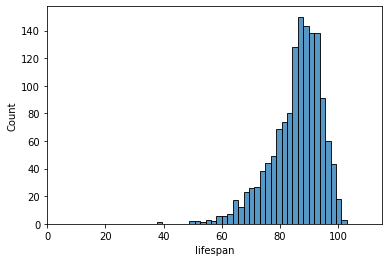

JEAN CLAUDE


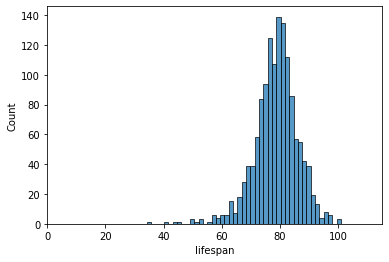

JACQUES


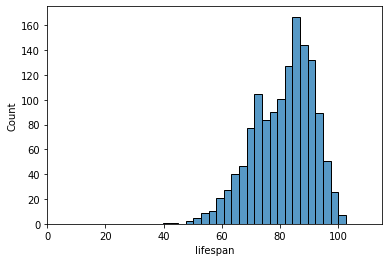

JEANNE


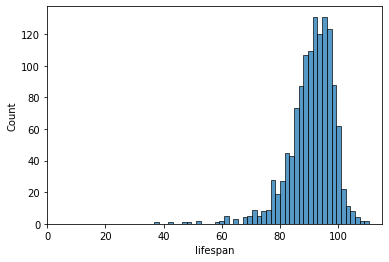

JEAN PIERRE


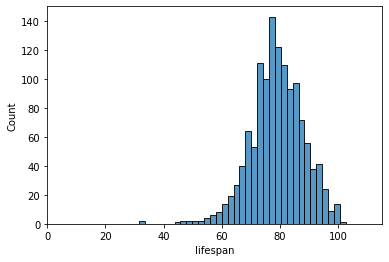

JOSEPH


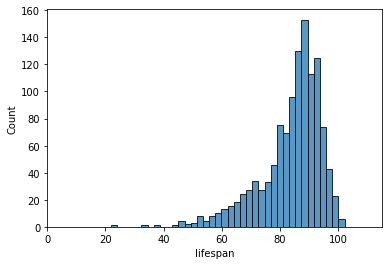

ROBERT


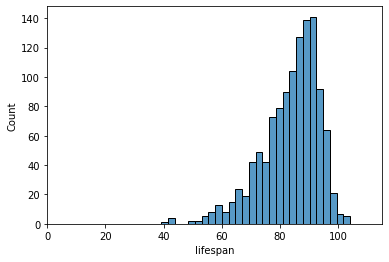

RENE


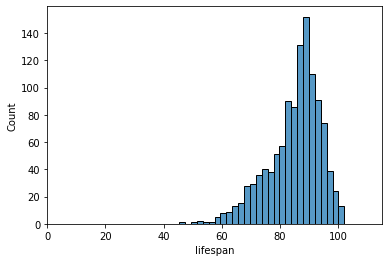

JEAN-PIERRE


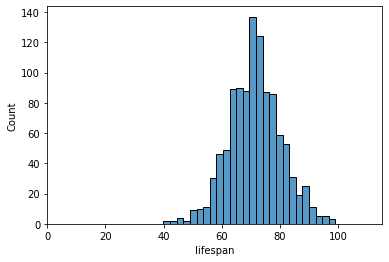

MARIA


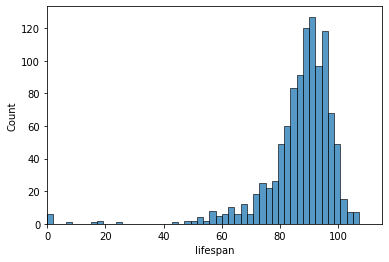

ROGER


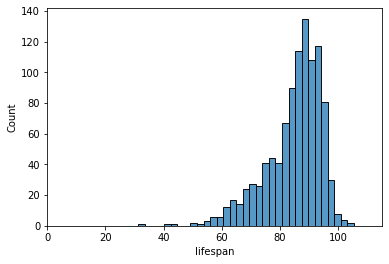

CLAUDE


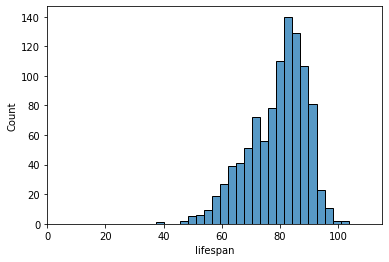

GEORGES


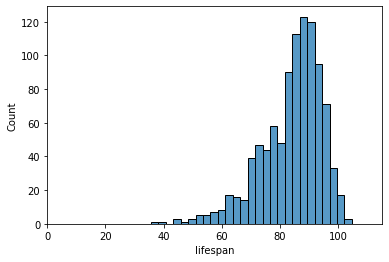

BERNARD


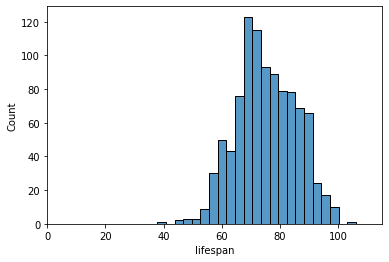

JEAN-CLAUDE


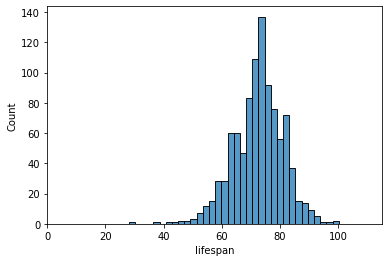

JEANNINE


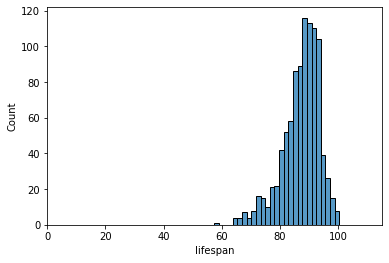

DANIEL


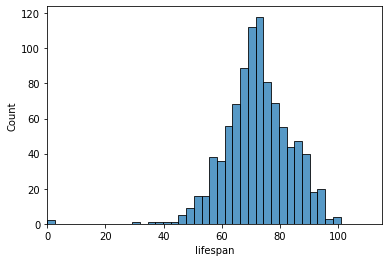

MOHAMED


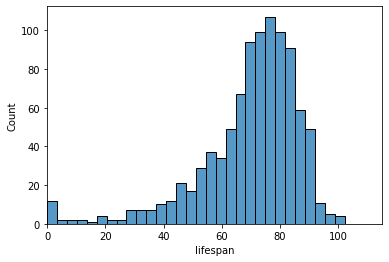

MARCEL


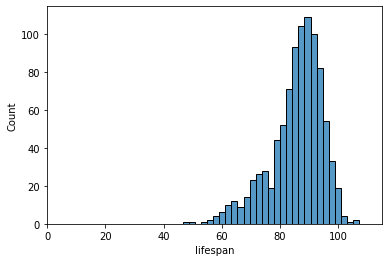

MONIQUE


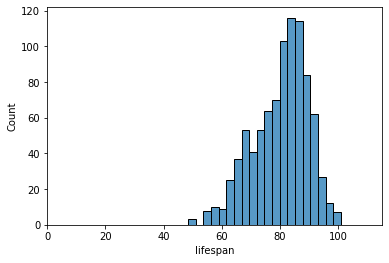

ANNE MARIE


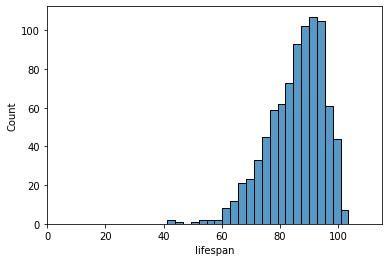

ALAIN


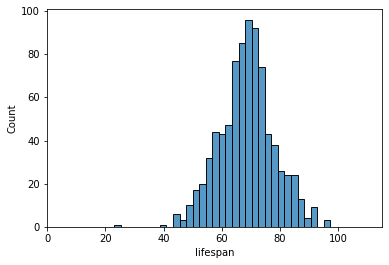

DENISE


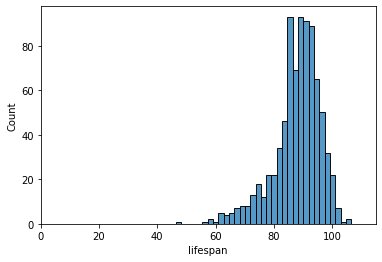

In [ ]:
for i in range (30):
  nom=df["prenom"].value_counts().index[i]
  print(nom)
  sns.histplot(data=df[df["prenom"]==f"{nom}"], x="lifespan")
  plt.xlim(0,115)
  plt.show()

In [ ]:
df["prenom"].value_counts().index[0]

'JEAN'

## naissance prenom

In [ ]:
df_naissance=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/nat2020.csv", sep=";")

In [ ]:
df_naissance

,sexe,preusuel,annais,nombre
0,1,_PRENOMS_RARES,1900,1250
1,1,_PRENOMS_RARES,1901,1342
2,1,_PRENOMS_RARES,1902,1330
3,1,_PRENOMS_RARES,1903,1286
4,1,_PRENOMS_RARES,1904,1430
...,...,...,...,...
667359,2,ZYNEB,2017,6
667360,2,ZYNEB,2018,5
667361,2,ZYNEB,2019,7
667362,2,ZYNEB,2020,8


In [ ]:
df_naissance.annais.replace("XXXX", np.nan, inplace=True)

In [ ]:
df_naissance.preusuel.replace("_PRENOMS_RARES", np.nan, inplace=True)

In [ ]:
df_naissance.dropna(inplace=True)

In [ ]:
df_naissance["annais"]=df_naissance["annais"].astype("int64")

In [ ]:
df_naissance["age_virtuel"]=2021-df_naissance["annais"]

In [ ]:
df_naissance["annais"].sort_values()

79148     1900
443113    1900
85728     1900
486991    1900
340616    1900
          ... 
181466    2020
181478    2020
359693    2020
359684    2020
667362    2020
Name: annais, Length: 630446, dtype: int64

In [ ]:
df_naissance["annais"]= pd.to_datetime(df_naissance["annais"] , format="%Y")

In [ ]:
df_naissance[(df_naissance["preusuel"]=="GRÉGOIRE") & (df_naissance["sexe"]==1) & (df_naissance["annais"]=="1973") ]

,sexe,preusuel,annais,nombre,age_virtuel
107604,1,GRÉGOIRE,1973-01-01,272,48


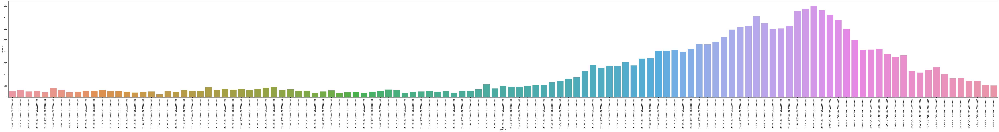

In [ ]:
plt.figure(figsize=(100,10))
labels=[x for x in range(1900, 2021)]
x=df_naissance[(df_naissance["preusuel"].str.contains("GRÉGOIRE")) & (df_naissance["sexe"]==1) ]["annais"]
plt.xticks(rotation='vertical')
# plt.xticks(x=df_naissance[(df_naissance["preusuel"].str.contains("GRÉGOIRE")) & (df_naissance["sexe"]==1) ]["annais"], labels=labels, rotation='vertical')
sns.barplot(data=df_naissance[(df_naissance["preusuel"]=="GRÉGOIRE") & (df_naissance["sexe"]==1) ], x="annais", y="nombre" )

In [ ]:
len([x for x in range(1900, 2021)])

121

In [ ]:
df_naissance[(df_naissance["preusuel"]=="FRANCE") & (df_naissance["sexe"]==2) ]

,sexe,preusuel,annais,nombre,age_virtuel
419876,2,FRANCE,1900-01-01,92,121
419877,2,FRANCE,1901-01-01,103,120
419878,2,FRANCE,1902-01-01,93,119
419879,2,FRANCE,1903-01-01,123,118
419880,2,FRANCE,1904-01-01,132,117
...,...,...,...,...,...
419992,2,FRANCE,2016-01-01,22,5
419993,2,FRANCE,2017-01-01,24,4
419994,2,FRANCE,2018-01-01,27,3
419995,2,FRANCE,2019-01-01,20,2


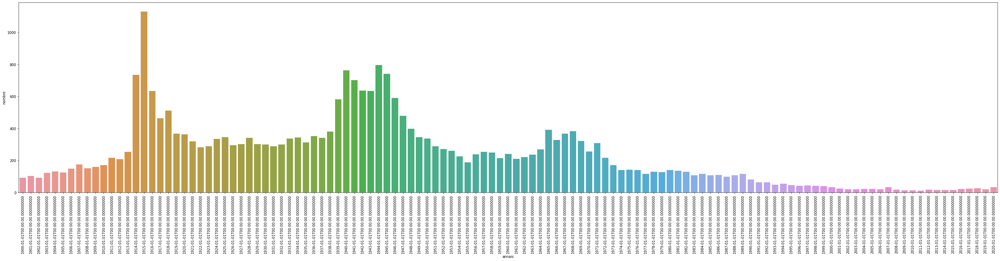

In [ ]:
plt.figure(figsize=(50,10))
plt.xticks(rotation='vertical')
# plt.xticks(x=df_naissance[(df_naissance["preusuel"].str.contains("GRÉGOIRE")) & (df_naissance["sexe"]==1) ]["annais"], labels=labels, rotation='vertical')
sns.barplot(data=df_naissance[(df_naissance["preusuel"]=="FRANCE") & (df_naissance["sexe"]==2) ], x="annais", y="nombre", dodge=False )

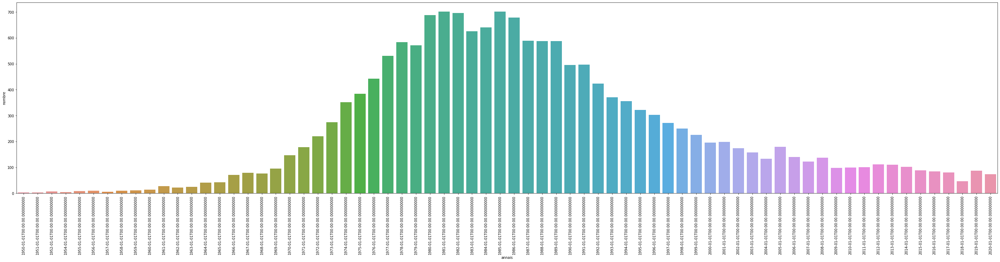

In [ ]:
plt.figure(figsize=(50,10))
plt.xticks(rotation='vertical')
# plt.xticks(x=df_naissance[(df_naissance["preusuel"].str.contains("GRÉGOIRE")) & (df_naissance["sexe"]==1) ]["annais"], labels=labels, rotation='vertical')
sns.barplot(data=df_naissance[(df_naissance["preusuel"]=="SAMIR") & (df_naissance["sexe"]==1) ], x="annais", y="nombre" ,dodge=False)

In [ ]:
df_naissance.groupby("preusuel").mean()

,sexe,nombre,age_virtuel
preusuel,,,
A,1.0,3.000000,32.000000
AADAM,1.0,3.500000,5.333333
AADEL,1.0,4.000000,40.000000
AADIL,1.0,6.040000,30.520000
AAHIL,1.0,5.000000,4.750000
...,...,...,...
ÖZGE,2.0,4.000000,14.666667
ÖZGÜR,1.0,3.000000,6.000000
ÖZKAN,1.0,3.000000,4.666667


In [ ]:
df_naissance.sort_values("age_virtuel", ascending=False)

,sexe,preusuel,annais,nombre,age_virtuel
221631,1,OLLIVIER,1900-01-01,12,121
63445,1,DENIS,1900-01-01,212,121
221744,1,OLYMPE,1900-01-01,3,121
247616,1,RUDOLPHE,1900-01-01,10,121
525637,2,MARIA-LOUISE,1900-01-01,3,121
...,...,...,...,...,...
463337,2,JOSEPHINE,2020-01-01,6,1
114425,1,HAROUNA,2020-01-01,33,1
114445,1,HAROUNE,2020-01-01,28,1
114458,1,HARPER,2020-01-01,7,1


In [ ]:
df_naissance['age_virtu_nombre']=df_naissance['age_weight']*df_naissance["nombre"]

In [ ]:
def funcA(d):
    if d >=105:
      return d*0.246/100
    return d*mortality.loc[d, "alive_percent"]/100
def funcB(d):
    if d >=105:
      return d*0.916/100
    return d*mortality.loc[d+104, "alive_percent"]/100

df_naissance['age_weight'] = df_naissance.apply(lambda x: funcA(x['age_virtuel']) if x['sexe'] == 1 else funcB(x['age_virtuel']), axis=1)
df_naissance

,sexe,preusuel,annais,nombre,age_virtuel,nombre_weight,age_weight
121,1,A,1980-01-01,3,41,2.92413,39.96311
122,1,A,1998-01-01,3,23,2.97312,22.79392
124,1,AADAM,2009-01-01,4,12,3.97860,11.93580
125,1,AADAM,2014-01-01,3,7,2.98521,6.96549
126,1,AADAM,2016-01-01,4,5,3.98116,4.97645
...,...,...,...,...,...,...,...
667358,2,ZYNEB,2016-01-01,6,5,5.97714,4.98095
667359,2,ZYNEB,2017-01-01,6,4,5.97792,3.98528
667360,2,ZYNEB,2018-01-01,5,3,4.98265,2.98959
667361,2,ZYNEB,2019-01-01,7,2,6.97970,1.99420


In [ ]:
def funcA(d, nombre):
    if d >=105:
      return nombre*0.246/100
    return nombre*mortality.loc[d, "alive_percent"]/100
def funcB(d, nombre):
    if d >=105:
      return nombre*0.916/100
    return nombre*mortality.loc[d+104, "alive_percent"]/100

df_naissance['nombre_weight'] = df_naissance.apply(lambda x: funcA(x['age_virtuel'],x["nombre"]) if x['sexe'] == 1 else funcB(x['age_virtuel'], x["nombre"]), axis=1)
df_naissance

,sexe,preusuel,annais,nombre,age_virtuel,nombre_weight
121,1,A,1980-01-01,3,41,2.92413
122,1,A,1998-01-01,3,23,2.97312
124,1,AADAM,2009-01-01,4,12,3.97860
125,1,AADAM,2014-01-01,3,7,2.98521
126,1,AADAM,2016-01-01,4,5,3.98116
...,...,...,...,...,...,...
667358,2,ZYNEB,2016-01-01,6,5,5.97714
667359,2,ZYNEB,2017-01-01,6,4,5.97792
667360,2,ZYNEB,2018-01-01,5,3,4.98265
667361,2,ZYNEB,2019-01-01,7,2,6.97970


In [ ]:
def funcA(d, row):
    if d >=105:
      return *0.246/100
    return d*mortality.loc[d, "alive_percent"]/100


    

In [ ]:
df_naissance.drop(columns="Entries", inplace=True)

In [ ]:
df_naissance["age_weight"]= df_naissance.apply(lambda x: (x["age_virtuel"]*0.9/100 if x["age_virtuel"] >=105 else x["age_virtuel"] * mortality.loc[x["age_virtuel"], "alive_percent"]/100) if x["sexe"]==1 else 0)

In [ ]:
def calc_age_virtu(x):
  if df_naissance["sexe"]==1:
    if x >105:
      return x*0.9/100

In [ ]:
test=df_naissance.groupby("preusuel", as_index=False).mean()  #.sort_values("age_weight", ascending=False)

In [ ]:
df_naissance[df_naissance["preusuel"]=="ERIC"]["age_virtu_nombre"].sum()/df_naissance[df_naissance["preusuel"]=="ERIC"]["nombre"].sum()

49.014711408321446

In [ ]:
(df_naissance[df_naissance["preusuel"]=="FRANCE"]["nombre_weight"]*df_naissance[df_naissance["preusuel"]=="FRANCE"]["age_virtuel"]).sum()/df_naissance[df_naissance["preusuel"]=="FRANCE"]["nombre_weight"].sum()

65.30051674566208

In [ ]:
df_naissance[df_naissance["preusuel"]=="PATRICK"]["age_virtu_nombre"].sum()

20713888.41173

In [ ]:
df_naissance[df_naissance["preusuel"]=="PATRICK"]["nombre"].sum()

395098

In [ ]:
46*96

4416

In [ ]:
df_naissance[df_naissance["preusuel"]=="ERIC"].head((50))

,sexe,preusuel,annais,nombre,age_virtuel,nombre_weight,age_weight,age_virtu_nombre
82462,1,ERIC,1900-01-01,14,121,0.03444,0.29766,4.16724
82463,1,ERIC,1901-01-01,23,120,0.05658,0.29520,6.78960
82464,1,ERIC,1902-01-01,26,119,0.06396,0.29274,7.61124
82465,1,ERIC,1903-01-01,19,118,0.04674,0.29028,5.51532
82466,1,ERIC,1904-01-01,19,117,0.04674,0.28782,5.46858
82467,1,ERIC,1905-01-01,36,116,0.08856,0.28536,10.27296
82468,1,ERIC,1906-01-01,24,115,0.05904,0.28290,6.78960
82469,1,ERIC,1907-01-01,36,114,0.08856,0.28044,10.09584
82470,1,ERIC,1908-01-01,23,113,0.05658,0.27798,6.39354
82471,1,ERIC,1909-01-01,60,112,0.14760,0.27552,16.53120


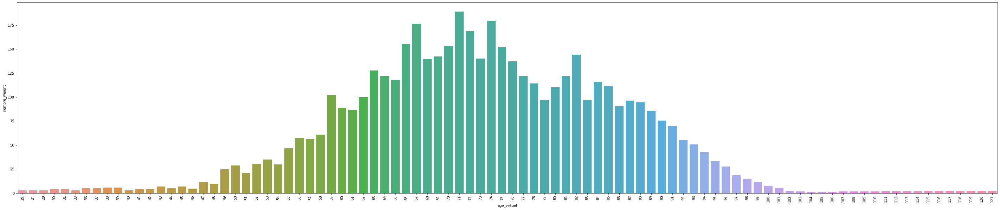

In [ ]:
plt.figure(figsize=(50,10))
plt.xticks(rotation='vertical')
sns.barplot(data=df_naissance[(df_naissance["preusuel"]=="MARIE") & (df_naissance["sexe"]==1) ], x="age_virtuel", y="nombre_weight", dodge=False )

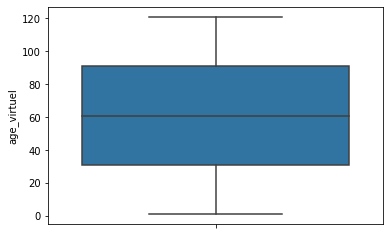

In [ ]:
sns.boxplot(data=df_naissance[(df_naissance["preusuel"]=="ERIC") & (df_naissance["sexe"]==1) ], y="age_virtuel")

In [ ]:
test[test["preusuel"]=="FRANCE"]

,preusuel,sexe,nombre,age_virtuel,nombre_weight,age_weight,age_virtu_nombre
9839,FRANCE,1.611111,151.560606,69.272727,89.243344,30.877738,5827.636508


In [ ]:
mortality.loc[209, "alive_percent"]

0.916

In [ ]:
mortality=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/mortality.csv")

In [ ]:
mortality[mortality["sexe"]==2]

,age,deaths,pop,sexe
105,0,290,100 000,2
106,1,56,99 710,2
107,2,21,99 653,2
108,3,13,99 632,2
109,4,11,99 619,2
...,...,...,...,...
205,100,31 218,5 171,2
206,101,34 290,3 557,2
207,102,36 204,2 337,2
208,103,38 566,1 491,2


In [ ]:
mortality["pop"]=[mortality["pop"][i].replace(" ", "") for i in range (mortality.shape[0])]

In [ ]:
mortality["pop"]=mortality["pop"].astype("int64")

In [ ]:
mortality["deaths"]=[mortality["deaths"][i].replace(" ", "") for i in range (mortality.shape[0])]
mortality["deaths"]=mortality["deaths"].astype("int64")

In [ ]:
mortality["alive_percent"]=(mortality["pop"])/1000

In [ ]:
mortality.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 210 entries, 0 to 209
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   age            210 non-null    int64  
 1   deaths         210 non-null    int64  
 2   pop            210 non-null    int64  
 3   sexe           210 non-null    int64  
 4   alive_percent  210 non-null    float64
dtypes: float64(1), int64(4)
memory usage: 8.3 KB


## Files that are not being used

In [ ]:
ctd=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/CTCD2021.csv")
ctd

,CTCD,REG,TNCC,NCC,NCCENR,LIBELLE
0,01D,84,1,CONSEIL DEPARTEMENTAL DE L AIN,Conseil départemental de L'Ain,Conseil départemental de L'Ain
1,02D,32,1,CONSEIL DEPARTEMENTAL DE L AISNE,Conseil départemental de L'Aisne,Conseil départemental de L'Aisne
2,03D,84,1,CONSEIL DEPARTEMENTAL DE L ALLIER,Conseil départemental de L'Allier,Conseil départemental de L'Allier
3,04D,93,1,CONSEIL DEPARTEMENTAL DES ALPES DE HAUTE PROVENCE,Conseil départemental des Alpes-de-Haute-Provence,Conseil départemental des Alpes-de-Haute-Provence
4,05D,93,1,CONSEIL DEPARTEMENTAL DES HAUTES ALPES,Conseil départemental des Hautes-Alpes,Conseil départemental des Hautes-Alpes
...,...,...,...,...,...,...
95,971D,1,1,CONSEIL DEPARTEMENTAL DE LA GUADELOUPE,Conseil départemental de La Guadeloupe,Conseil départemental de La Guadeloupe
96,972R,2,3,COLLECTIVITE TERRITORIALE UNIQUE DE LA MARTINIQUE,Collectivité territoriale unique de La Martinique,Collectivité territoriale unique de La Martinique
97,973R,3,3,COLLECTIVITE TERRITORIALE UNIQUE DE LA GUYANE,Collectivité territoriale unique de La Guyane,Collectivité territoriale unique de La Guyane
98,974D,4,1,CONSEIL DEPARTEMENTAL DE LA REUNION,Conseil départemental de La Réunion,Conseil départemental de La Réunion


In [ ]:
test=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/France2018.txt", sep="\t", engine="python", encoding="latin_1")
test

,ACTUAL,CHEFLIEU,CDC,RANG,REG,DEP,COM,AR,CT,MODIF,POLE,TNCC,ARTMAJ,NCC,ARTMIN,NCCENR,ARTICLCT,NCCCT
0,1,0.0,0.0,NaN,84.0,01,1,2.0,8.0,0,NaN,5,(L'),ABERGEMENT-CLEMENCIAT,(L'),Abergement-Clémenciat,NaN,Châtillon-sur-Chalaronne
1,1,0.0,0.0,NaN,84.0,01,2,1.0,1.0,0,NaN,5,(L'),ABERGEMENT-DE-VAREY,(L'),Abergement-de-Varey,NaN,Ambérieu-en-Bugey
2,3,NaN,NaN,NaN,84.0,01,3,NaN,NaN,1,01165,1,NaN,AMAREINS,NaN,Amareins,NaN,NaN
3,1,1.0,0.0,NaN,84.0,01,4,1.0,1.0,1,NaN,1,NaN,AMBERIEU-EN-BUGEY,NaN,Ambérieu-en-Bugey,NaN,Ambérieu-en-Bugey
4,1,0.0,0.0,NaN,84.0,01,5,2.0,22.0,0,NaN,1,NaN,AMBERIEUX-EN-DOMBES,NaN,Ambérieux-en-Dombes,NaN,Villars-les-Dombes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39936,1,0.0,0.0,NaN,6.0,976,13,NaN,13.0,0,NaN,0,NaN,M'TSANGAMOUJI,NaN,M'Tsangamouji,NaN,Tsingoni
39937,1,1.0,0.0,NaN,6.0,976,14,NaN,10.0,0,NaN,1,NaN,OUANGANI,NaN,Ouangani,NaN,Ouangani
39938,1,1.0,0.0,NaN,6.0,976,15,NaN,11.0,0,NaN,0,NaN,PAMANDZI,NaN,Pamandzi,NaN,Pamandzi
39939,1,1.0,0.0,NaN,6.0,976,16,NaN,12.0,0,NaN,0,NaN,SADA,NaN,Sada,NaN,Sada


In [ ]:
departement=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/departement2021.csv")
departement


,DEP,REG,CHEFLIEU,TNCC,NCC,NCCENR,LIBELLE
0,01,84,01053,5,AIN,Ain,Ain
1,02,32,02408,5,AISNE,Aisne,Aisne
2,03,84,03190,5,ALLIER,Allier,Allier
3,04,93,04070,4,ALPES DE HAUTE PROVENCE,Alpes-de-Haute-Provence,Alpes-de-Haute-Provence
4,05,93,05061,4,HAUTES ALPES,Hautes-Alpes,Hautes-Alpes
...,...,...,...,...,...,...,...
96,971,1,97105,3,GUADELOUPE,Guadeloupe,Guadeloupe
97,972,2,97209,3,MARTINIQUE,Martinique,Martinique
98,973,3,97302,3,GUYANE,Guyane,Guyane
99,974,4,97411,0,LA REUNION,La Réunion,La Réunion


In [ ]:
canton=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/canton2021.csv")
canton

,CAN,DEP,REG,COMPCT,BURCENTRAL,TNCC,NCC,NCCENR,LIBELLE,TYPECT
0,0101,01,84,1.0,01004,1,AMBERIEU EN BUGEY,Ambérieu-en-Bugey,Ambérieu-en-Bugey,C
1,0102,01,84,1.0,01024,1,ATTIGNAT,Attignat,Attignat,C
2,0103,01,84,1.0,01033,0,VALSERHONE,Valserhône,Valserhône,C
3,0104,01,84,1.0,01034,0,BELLEY,Belley,Belley,C
4,0105,01,84,2.0,01053,0,BOURG EN BRESSE 1,Bourg-en-Bresse-1,Bourg-en-Bresse-1,C
...,...,...,...,...,...,...,...,...,...,...
2285,97613,976,6,1.0,97617,0,TSINGONI,Tsingoni,Tsingoni,C
2286,97696,976,6,NaN,97602,0,BANDRABOUA,Bandraboua,Bandraboua,V
2287,97697,976,6,NaN,97603,0,BANDRELE,Bandrele,Bandrele,V
2288,97698,976,6,NaN,97610,0,KOUNGOU,Koungou,Koungou,V


In [ ]:
df[df["lieunaiss_str"]=="01034"]

,nomprenom,sexe,datenaiss,lieunaiss,commnaiss,paysnaiss,datedeces,lieudeces,actedeces,lieunaiss_str,birthdate,deathdate,lifespan,nomprenomsplit,nom,prenom,Range
48,COTTAREL*EDITH JEANNINE/,2,19380507,01034,BELLEY,FRANCE,20200120,01034,21,01034,1938-05-07,2020-01-20,81.71,"[COTTAREL, EDITH JEANNINE/]",COTTAREL,EDITH JEANNINE,"(80.0, 85.0]"
49,GUILLOT*JEAN-NOEL/,1,19451210,01034,BELLEY,FRANCE,20200123,01034,23,01034,1945-12-10,2020-01-23,74.12,"[GUILLOT, JEAN-NOEL/]",GUILLOT,JEAN-NOEL,"(70.0, 75.0]"
52,BARLET*PAULETTE FRANCE JOSEPHINE/,2,19230526,01034,BELLEY,FRANCE,20200118,01034,20,01034,1923-05-26,2020-01-18,96.65,"[BARLET, PAULETTE FRANCE JOSEPHINE/]",BARLET,PAULETTE FRANCE JOSEPHINE,"(95.0, 100.0]"
60,GARIN*JEANINE ALICE/,2,19620809,01034,BELLEY,FRANCE,20200106,01034,4,01034,1962-08-09,2020-01-06,57.41,"[GARIN, JEANINE ALICE/]",GARIN,JEANINE ALICE,"(55.0, 60.0]"
92,FALCAND*JEAN FRANCOIS/,1,19540617,01034,BELLEY,FRANCE,20200106,01053,13,01034,1954-06-17,2020-01-06,65.56,"[FALCAND, JEAN FRANCOIS/]",FALCAND,JEAN FRANCOIS,"(65.0, 70.0]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
635503,CASEROTTO*GRAZIELLA/,2,19320218,01034,BELLEY,FRANCE,20201207,38382,124,01034,1932-02-18,2020-12-07,88.80,"[CASEROTTO, GRAZIELLA/]",CASEROTTO,GRAZIELLA,"(85.0, 90.0]"
637492,MONESTIER*ALAIN FRANCOIS/,1,19480419,01034,BELLEY,FRANCE,20201207,42071,142,01034,1948-04-19,2020-12-07,72.64,"[MONESTIER, ALAIN FRANCOIS/]",MONESTIER,ALAIN FRANCOIS,"(70.0, 75.0]"
658260,GENOD*ANDRE PAUL/,1,19550905,1034,BELLEY,FRANCE,20201126,69384,1206,01034,1955-09-05,2020-11-26,65.23,"[GENOD, ANDRE PAUL/]",GENOD,ANDRE PAUL,"(65.0, 70.0]"
658633,MORET*MARIE-CHRISTINE MADELEINE ARLETTE/,2,19580118,1034,BELLEY,FRANCE,20201126,69389,544,01034,1958-01-18,2020-11-26,62.86,"[MORET, MARIE-CHRISTINE MADELEINE ARLETTE/]",MORET,MARIE-CHRISTINE MADELEINE ARLETTE,"(60.0, 65.0]"


In [ ]:
communes

,TYPECOM,COM,REG,DEP,CTCD,ARR,TNCC,NCC,NCCENR,LIBELLE,CAN,COMPARENT
0,COM,01001,84.0,01,01D,012,5,ABERGEMENT CLEMENCIAT,Abergement-Clémenciat,L'Abergement-Clémenciat,0108,NaN
1,COM,01002,84.0,01,01D,011,5,ABERGEMENT DE VAREY,Abergement-de-Varey,L'Abergement-de-Varey,0101,NaN
2,COM,01004,84.0,01,01D,011,1,AMBERIEU EN BUGEY,Ambérieu-en-Bugey,Ambérieu-en-Bugey,0101,NaN
3,COM,01005,84.0,01,01D,012,1,AMBERIEUX EN DOMBES,Ambérieux-en-Dombes,Ambérieux-en-Dombes,0122,NaN
4,COM,01006,84.0,01,01D,011,1,AMBLEON,Ambléon,Ambléon,0104,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
37737,COM,97613,6.0,976,976D,NaN,0,M TSANGAMOUJI,M'Tsangamouji,M'Tsangamouji,97613,NaN
37738,COM,97614,6.0,976,976D,NaN,1,OUANGANI,Ouangani,Ouangani,97610,NaN
37739,COM,97615,6.0,976,976D,NaN,0,PAMANDZI,Pamandzi,Pamandzi,97611,NaN
37740,COM,97616,6.0,976,976D,NaN,0,SADA,Sada,Sada,97612,NaN


In [ ]:
canton[canton["NCCENR"]=="Belley"]

,CAN,DEP,REG,COMPCT,BURCENTRAL,TNCC,NCC,NCCENR,LIBELLE,TYPECT
3,0104,01,84,1.0,01034,0,BELLEY,Belley,Belley,C


In [ ]:
canton[canton["CAN"]=="6912"]
# 69382

,CAN,DEP,REG,COMPCT,BURCENTRAL,TNCC,NCC,NCCENR,LIBELLE,TYPECT
1632,6912,69,84,1.0,69255,0,VAUGNERAY,Vaugneray,Vaugneray,C


In [ ]:
mask=df["paysnaiss"].isnull()==True
for s in df.loc[mask,"lieunaiss_str"]:
  if s in [x for x in pays["COG"] if pays[pays["COG"]==x].shape[0]<2]:
    mask_1=(df["paysnaiss"].isnull()==True) & (df["lieunaiss_str"]==s) 
    mask_2=pays["COG"]==s
    df.loc[mask_1, "paysnaiss"]=pays.loc[mask_2, "LIBCOG"].values[0]

In [ ]:
df["Canton"]="NaN"
# for s in canton["BURCENTRAL"]:
for s in communes["COM"]:
  # NCC
  mask=df["lieunaiss_str"]==s
  mask1=communes["COM"]==s
  df.loc[mask, "Canton"]=communes.loc[mask1, "CAN"].values[0]

In [ ]:
# mask=df["commnaiss"]=="LA JUMELLIERE"
mask1=communes["NCC"]=="LA JUMELLIERE"
mask1=communes["NCC"].str.contains("JUMELLIERE")
communes.loc[mask1, "CAN"].values[0]

nan

In [ ]:
communes[communes["NCC"].str.contains("SAINT JUST")]

In [ ]:
communes[communes["COM"]=="69382"]

,TYPECOM,COM,REG,DEP,CTCD,ARR,TNCC,NCC,NCCENR,LIBELLE,CAN,COMPARENT
29495,ARM,69382,84.0,69,69M,691,0,LYON 2E ARRONDISSEMENT,Lyon 2e Arrondissement,Lyon 2e Arrondissement,NaN,69123.0


In [ ]:
communes[communes["NCC"]=="LA JUMELLIERE"]

,TYPECOM,COM,REG,DEP,CTCD,ARR,TNCC,NCC,NCCENR,LIBELLE,CAN,COMPARENT


In [ ]:
df[(df["paysnaiss"]=="FRANCE")& (df["Canton"]!="NaN") & (df["Canton"].isnull()!=True)]


,nomprenom,sexe,datenaiss,lieunaiss,commnaiss,paysnaiss,datedeces,lieudeces,actedeces,lieunaiss_str,birthdate,deathdate,lifespan,nomprenomsplit,nom,prenom,Range,Canton
1,GOURBIERE*MICHEL JOSEPH MARIUS/,1,19520222,42207,SAINT-CHAMOND,FRANCE,20200107,01004,6,42207,1952-02-22,2020-01-07,67.88,"[GOURBIERE, MICHEL JOSEPH MARIUS/]",GOURBIERE,MICHEL JOSEPH MARIUS,"(65.0, 70.0]",4213
4,LELYS*JOHNNY GABRIEL LUC/,1,19620219,79270,SAINT-MAIXENT-L'ECOLE,FRANCE,20200116,01004,15,79270,1962-02-19,2020-01-16,57.91,"[LELYS, JOHNNY GABRIEL LUC/]",LELYS,JOHNNY GABRIEL LUC,"(55.0, 60.0]",7915
5,VAUDET*COLETTE CHRISTIANE/,2,19320721,01384,SAINT-RAMBERT-EN-BUGEY,FRANCE,20200110,01004,9,01384,1932-07-21,2020-01-10,87.47,"[VAUDET, COLETTE CHRISTIANE/]",VAUDET,COLETTE CHRISTIANE,"(85.0, 90.0]",0101
8,AMBROSI*MICHELLE HELENE/,2,19380326,01304,PONT-D'AIN,FRANCE,20200124,01004,19,01304,1938-03-26,2020-01-24,81.83,"[AMBROSI, MICHELLE HELENE/]",AMBROSI,MICHELLE HELENE,"(80.0, 85.0]",0116
10,GRINAND*MARCELLE EUGENIE/,2,19270426,01004,AMBERIEU-EN-BUGEY,FRANCE,20200105,01004,5,01004,1927-04-26,2020-01-05,92.70,"[GRINAND, MARCELLE EUGENIE/]",GRINAND,MARCELLE EUGENIE,"(90.0, 95.0]",0101
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
679912,BOUVART*GUILLAUME ALEXANDRE/,1,19890319,97415,SAINT-PAUL,FRANCE,20201021,99501,1121,97415,1989-03-19,2020-10-21,31.59,"[BOUVART, GUILLAUME ALEXANDRE/]",BOUVART,GUILLAUME ALEXANDRE,"(30.0, 35.0]",97497
679913,LEPORE*LAURENT/,1,19671226,19031,BRIVE-LA-GAILLARDE,FRANCE,20201127,99326,1277,19031,1967-12-26,2020-11-27,52.92,"[LEPORE, LAURENT/]",LEPORE,LAURENT,"(50.0, 55.0]",1999
679917,ETCHEVARNE*RACHEL DOMINIQUE LOLITA/,2,19651204,55029,BAR-LE-DUC,FRANCE,20201030,99341,1472,55029,1965-12-04,2020-10-30,54.91,"[ETCHEVARNE, RACHEL DOMINIQUE LOLITA/]",ETCHEVARNE,RACHEL DOMINIQUE LOLITA,"(50.0, 55.0]",5598
679918,PAIXAO*ALEX GUILLAUME RUIVO/,1,19831219,92064,SAINT-CLOUD,FRANCE,20180720,99134,2163,92064,1983-12-19,2018-07-20,34.59,"[PAIXAO, ALEX GUILLAUME RUIVO/]",PAIXAO,ALEX GUILLAUME RUIVO,"(30.0, 35.0]",9223


In [ ]:
communes_can=[x for x in communes["CAN"]]
df.loc[df["lieunaiss_str"].isin(communes_com), "paysnaiss"] = "FRANCE"

In [ ]:
cities=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/cities.csv")
cities

,id,department_code,insee_code,zip_code,name,slug,gps_lat,gps_lng
0,1,01,01001,1400.0,L'Abergement-Clémenciat,l abergement clemenciat,46.156782,4.924699
1,2,01,01002,1640.0,L'Abergement-de-Varey,l abergement de varey,46.010086,5.428759
2,3,01,01004,1500.0,Ambérieu-en-Bugey,amberieu en bugey,45.958409,5.375992
3,4,01,01005,1330.0,Ambérieux-en-Dombes,amberieux en dombes,46.000120,4.910602
4,5,01,01006,1300.0,Ambléon,ambleon,45.746427,5.602492
...,...,...,...,...,...,...,...,...
35848,35849,988,NaN,98831.0,Touho,touho,-20.780538,165.232815
35849,35850,988,NaN,98833.0,Voh,voh,-20.949963,164.687186
35850,35851,988,NaN,98834.0,Yaté,yate,-22.159370,166.944270
35851,35852,988,NaN,98818.0,Kouaoua,kouaoua,-21.396181,165.828447


In [ ]:
cities["zip_code"].fillna(0, inplace=True)
cities["zip_code"]=cities["zip_code"].apply(lambda x: int(x) )

In [ ]:
cities

,id,department_code,insee_code,zip_code,name,slug,gps_lat,gps_lng
0,1,01,01001,1400,L'Abergement-Clémenciat,l abergement clemenciat,46.156782,4.924699
1,2,01,01002,1640,L'Abergement-de-Varey,l abergement de varey,46.010086,5.428759
2,3,01,01004,1500,Ambérieu-en-Bugey,amberieu en bugey,45.958409,5.375992
3,4,01,01005,1330,Ambérieux-en-Dombes,amberieux en dombes,46.000120,4.910602
4,5,01,01006,1300,Ambléon,ambleon,45.746427,5.602492
...,...,...,...,...,...,...,...,...
35848,35849,988,NaN,98831,Touho,touho,-20.780538,165.232815
35849,35850,988,NaN,98833,Voh,voh,-20.949963,164.687186
35850,35851,988,NaN,98834,Yaté,yate,-22.159370,166.944270
35851,35852,988,NaN,98818,Kouaoua,kouaoua,-21.396181,165.828447


In [ ]:
cities[cities["zip_code"]>98500]

,id,department_code,insee_code,zip_code,name,slug,gps_lat,gps_lng
35771,35772,987,NaN,98760,Anaa,anaa,-16.941907,-144.864617
35774,35775,987,NaN,98730,Bora-Bora,bora bora,-16.504169,-151.736662
35784,35785,987,NaN,98731,Huahine,huahine,-16.728509,-151.013455
35785,35786,987,NaN,98709,Mahina,mahina,-17.505858,-149.487398
35788,35789,987,NaN,98732,Maupiti,maupiti,-16.443877,-152.256756
35789,35790,987,NaN,98729,Moorea-Maiao,moorea maiao,-17.533261,-149.838625
35804,35805,987,NaN,98753,Rurutu,rurutu,-22.478054,-151.337121
35807,35808,987,NaN,98720,Taiarapu-Est,taiarapu est,-17.753299,-149.234402
35811,35812,987,NaN,98783,Tatakoto,tatakoto,-17.344712,-138.392260
35815,35816,987,NaN,98784,Tureia,tureia,-20.826808,-138.539607


In [ ]:
cities[cities["zip_code"]=="75041"]

,id,department_code,insee_code,zip_code,name,slug,gps_lat,gps_lng


In [ ]:
cities[cities["zip_code"]==0]

,id,department_code,insee_code,zip_code,name,slug,gps_lat,gps_lng
35763,35764,984,NaN,0,Îles Saint-Paul et Nouvelle-Amsterdam,iles saint paul et nouvelle amsterdam,-37.834479,77.554616
35764,35765,984,NaN,0,Archipel des Kerguelen,archipel des kerguelen,-49.237442,69.622759
35765,35766,984,NaN,0,Archipel des Crozet,archipel des crozet,-46.408809,51.033437
35766,35767,984,NaN,0,La Terre-Adélie,la terre adelie,-69.172639,138.960274
35767,35768,984,NaN,0,Îles Éparses de l'océan Indien,iles eparses de l ocean indien,-21.490953,39.688104
35768,35769,986,NaN,0,Alo,alo,9.520280,42.110000
35769,35770,986,NaN,0,Wallis et Futuna,wallis et futuna,-13.817332,-177.148965
35770,35771,986,NaN,0,Uvea,uvea,-13.254494,-176.257826
35772,35773,987,NaN,0,Arue,arue,-17.531084,-149.517568
35773,35774,987,NaN,0,Arutua,arutua,-15.525215,-146.526811


In [ ]:
COM_csv["Codes"].apply(lambda x: "".join(x))

0           975 01
1           975 02
2      975 02 0101
3      975 02 0102
4           977 01
          ...     
104        98 8 30
105        98 8 31
106        98 8 32
107        98 8 33
108         989 01
Name: Codes, Length: 109, dtype: object

In [ ]:
COM_csv[COM_csv["Codes"]=="98818"]

,Codes,Communes,Iris,Type
92,98818,Nouméa,NaN,NaN


In [ ]:

COM_csv=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/COM 2021-09-10 - Sheet1.csv")
COM_csv["Codes"]=COM_csv["Codes"].apply(lambda x: x.strip().replace(" ", ""))
df_merge=df_merge.merge(COM_csv, left_on="lieunaiss_str", right_on="Codes", how="left")
mask=(df_merge["paysnaiss"].isnull()==True) & (df_merge["Codes"].isnull()==False)
df_merge.loc[mask, "paysnaiss"]="FRANCE"

# set([x for x in df_merge[(df_merge["Codes"].isnull()!=True) & (df_merge["paysnaiss"].isnull()==True)]["Codes"]])

mask=((df_merge["Codes"].isnull()!=True) & (df_merge["paysnaiss"].isnull()==True))
df_merge.loc[mask, "paysnaiss"]="FRANCE"

movement=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/mvtcommune2021.csv")
df_merge=df_merge.merge(movement, left_on="lieunaiss_str", right_on="COM_AV", how="left")

df_merge=df_merge.merge(communes, left_on="commnaiss", right_on="NCC", how="left")

mask=((df_merge["paysnaiss"].isnull()==True) & (df_merge["COM_AV"].isnull()==False))
df_merge.loc[mask, "paysnaiss"]="FRANCE"

mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["NCC_y"].isnull()!=True) 
df_merge.loc[mask,"paysnaiss" ]="FRANCE"  

for x in ["ILES DU VENT","NOUVELLE CALEDONIE","M'TSANGAMOUJI","COLL TERR MAYOTTE","KANI-KELI","ILES SOUS LES VENTS","ARCHIPEL DES MARQUISES", "ARCHIPEL TUAMOTU", "ARCHIPEL WALLIS ET FUTUNA",\
          "PALALDA", "LOMPNES", "HAUTEVILLE-LOMPNES", "ARCHIPEL TUBUAI"]:
  mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]==f"{x}") 
  df_merge.loc[mask,"paysnaiss" ]="FRANCE"

for x in range (100):
  mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]==f"DEPARTEMENT {x:02d}") 
  df_merge.loc[mask,"paysnaiss" ]="FRANCE"

Algerie_francaise=["DEPARTEMENT D'ORAN", "DEPARTEMENT D'ALGER", "DEPARTEMENT DE CONSTANTINE", "SUD DE L'ALGERIE", "DEPARTEMENT D'ALGER", "SUD DE L'ALGERIE", "DEPARTEMENT D'ALGER", \
                   "DEPARTEMENT D'ORAN"]
for dep in Algerie_francaise:
  mask=((df_merge["paysnaiss"].isnull()==True) & (df_merge["commnaiss"]==dep))
  df_merge.loc[mask, "paysnaiss"]="FRANCE(ALGERIE)"


mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIENNE GUINEE") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(GUINEE)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIENNE COTE D'IVOIRE") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(COTE D'IVOIRE)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="SOUDAN FRANCAIS") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(SOUDAN)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="EX-DAHOMEY") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(BENIN)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="TERR FRANCAIS AFARS ISSAS") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(DJIBOUTI)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="MOYEN CONGO") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(CONGO)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN GABON") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(GABON)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN MADAGASCAR") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(MADAGASCAR)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN SENEGAL") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(SENEGAL)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN CAMEROUN") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(CAMEROUN)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="OUBANGUI CHARI") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(CENTRAFRIQUE)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN TOGO") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(TOGO)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN TCHAD") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(TCHAD)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN MAURITANIE") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(MAURITANIE)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN NIGER") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(NIGER)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANC CODOM FRANC-BRIT") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(VANUATU)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN NIGER") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(NIGER)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="EX-HAUTE VOLTA") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(BURKINA FASO)"


In [ ]:
# COM_csv=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/COM 2021-09-10 - Sheet1.csv")
# COM_csv["Codes"]=COM_csv["Codes"].apply(lambda x: x.strip().replace(" ", ""))
# COM_csv

## unused code


In [ ]:
pays_2=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/country_hand.csv")
pays_2["CODE"]=pays_2["CODE"].astype("str")
pays_2

,CODE,COUNTRY
0,99125,ALBANIE
1,99109,ALLEMAGNE
2,99130,ANDORRE
3,99135,ARUBA
4,99110,AUTRICHE
...,...,...
263,99505,TERR. DES ETATS-UNIS D'AMERIQUE EN OCEANIE
264,99502,TOKELAU
265,99509,TONGA
266,99511,TUVALU


In [ ]:
[x for x in pays["COG"] if pays[pays["COG"]==x].shape[0]<2]

In [ ]:
pays[pays["COG"]=="99336"]

,COG,ACTUAL,CAPAY,CRPAY,ANI,LIBCOG,LIBENR,ANCNOM,CODEISO2,CODEISO3,CODENUM3
157,99336,1,98201,NaN,1960.0,MAURITANIE,RÉPUBLIQUE ISLAMIQUE DE MAURITANIE,NaN,MR,MRT,478.0


In [ ]:
COM_csv_codes=[x for x in COM_csv["Codes"]]
df.loc[df["lieunaiss_str"].isin(COM_csv_codes), "paysnaiss"] = "FRANCE"

In [ ]:
mask=df["paysnaiss"].isnull()==True
for s in df.loc[mask,"lieunaiss"]:
  country_list=[x for x in pays["COG"] if pays[pays["COG"]==x].shape[0]<2]
  mask_2=pays["COG"]==s
  df.loc[df["lieunaiss_str"].isin(country_list), "paysnaiss"] = pays.loc[mask_2, "LIBCOG"]

In [ ]:
mask=df["paysnaiss"].isnull()==True
for s in df.loc[mask,"lieunaiss"]:
    if s in [x for x in pays["COG"] if pays[pays["COG"]==x].shape[0]<2]:
      mask_2=(pays["COG"]==s)
      mask_1=(df["paysnaiss"].isnull()==True) & (df["lieunaiss"]==s) 
      print(df.loc[mask_1, "paysnaiss"])

          

In [ ]:
s="99243"
mask_2=(pays["COG"]==s)
pays.loc[mask_2, "LIBCOG"].values[0]

'VIET NAM'

In [ ]:
 mask_1=((df["paysnaiss"].isnull()==True) & (df["lieunaiss"]=="99243") )
df.loc[mask_1, "paysnaiss"]

1793      NaN
494114    NaN
Name: paysnaiss, dtype: object

In [ ]:
df[df["paysnaiss"].isnull()==True]

,nomprenom,sexe,datenaiss,lieunaiss,commnaiss,paysnaiss,datedeces,lieudeces,actedeces,lieunaiss_str
1793,TRAN*THI-LAN/,2,19330101,99243,BINH-LAP TAN-AN,NaN,20200109,06004,54,99243
2088,COZZI*NINO LIBERO/,1,19201021,99127,CASTELNUOVO DEL FRIULI,NaN,20200103,06030,5,99127
5392,DE ALMEIDA HENRIQUES*MARIA ISABEL/,2,19330902,99139,CASTELOES,NaN,20191206,13035,63,99139
5808,RAYNAUD*CHRISTIANE JEANNE GEORGETTE/,2,19310101,99351,TUNIS,NaN,20200106,13105,1,99351
8572,MAYODORMO TORRES*MARIA/,2,19300124,99134,VALENCIA,NaN,20200119,17300,89,99134
...,...,...,...,...,...,...,...,...,...,...
664595,KONTE*SAMBA/,1,19481230,99336,TAMCHEKETT,NaN,20201121,76540,3012,99336
673093,MOREIRA*ARMENIO/,1,19431118,99139,AROUCA,NaN,20201204,89360,4,99139
675490,N'DIAYE*MAMADOU SAMBA/,1,19461231,99335,MELGA C/ KAYES,NaN,20201216,93010,586,99335
679105,ABDOU*MARIAMA/,2,19730313,99397,BANGOI-KOUNI,NaN,20201215,97611,456,99397


In [ ]:
communes=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/commune2021.csv")

df_merge=df.merge(communes, left_on="lieunaiss_str", right_on="COM", how="left")
mask=(df_merge["paysnaiss"].isnull()==True) & (df_merge["NCC"].isnull()==False)
df_merge.loc[mask, "paysnaiss"]="FRANCE"

In [ ]:
df[df["nomprenom"]=="BOYKE*MAUSLEY MAURICE/"]

,nomprenom,sexe,datenaiss,lieunaiss,commnaiss,paysnaiss,datedeces,lieudeces,actedeces,lieunaiss_str
236241,BOYKE*MAUSLEY MAURICE/,1,19320313,99425,SAINT GEORGES,TERRITOIRES DU ROYAUME-UNI AUX,20200412,93048,357,99425


In [ ]:
COM_csv=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/COM 2021-09-10 - Sheet1.csv")
COM_csv["Codes"]=COM_csv["Codes"].apply(lambda x: x.strip().replace(" ", ""))

df_merge=df_merge.merge(COM_csv, left_on="lieunaiss_str", right_on="Codes", how="left")

mask=(df_merge["paysnaiss"].isnull()==True) & (df_merge["Codes"].isnull()==False)
df_merge.loc[mask, "paysnaiss"]="FRANCE"
mask=((df_merge["Codes"].isnull()!=True) & (df_merge["paysnaiss"].isnull()==True))
df_merge.loc[mask, "paysnaiss"]="FRANCE"

In [ ]:

df_merge=df_merge.merge(communes, left_on="commnaiss", right_on="NCC", how="left")

In [ ]:
movement=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/mvtcommune2021.csv")
df_merge=df_merge.merge(movement, left_on="lieunaiss_str", right_on="COM_AV", how="left")

In [ ]:

for x in ["ILES DU VENT","NOUVELLE CALEDONIE","M'TSANGAMOUJI","COLL TERR MAYOTTE","KANI-KELI","ILES SOUS LES VENTS","ARCHIPEL DES MARQUISES", "ARCHIPEL TUAMOTU", "ARCHIPEL WALLIS ET FUTUNA",\
          "PALALDA", "LOMPNES", "HAUTEVILLE-LOMPNES", "ARCHIPEL TUBUAI"]:
  mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]==f"{x}") 
  df_merge.loc[mask,"paysnaiss" ]="FRANCE"

for x in range (100):
  mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]==f"DEPARTEMENT {x:02d}") 
  df_merge.loc[mask,"paysnaiss" ]="FRANCE"

Algerie_francaise=["DEPARTEMENT D'ORAN", "DEPARTEMENT D'ALGER", "DEPARTEMENT DE CONSTANTINE", "SUD DE L'ALGERIE", "DEPARTEMENT D'ALGER", "SUD DE L'ALGERIE", "DEPARTEMENT D'ALGER", \
                   "DEPARTEMENT D'ORAN"]
for dep in Algerie_francaise:
  mask=((df_merge["paysnaiss"].isnull()==True) & (df_merge["commnaiss"]==dep))
  df_merge.loc[mask, "paysnaiss"]="FRANCE(ALGERIE)"


mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIENNE GUINEE") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(GUINEE)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIENNE COTE D'IVOIRE") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(COTE D'IVOIRE)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="SOUDAN FRANCAIS") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(SOUDAN)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="EX-DAHOMEY") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(BENIN)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="TERR FRANCAIS AFARS ISSAS") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(DJIBOUTI)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="MOYEN CONGO") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(CONGO)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN GABON") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(GABON)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN MADAGASCAR") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(MADAGASCAR)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN SENEGAL") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(SENEGAL)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN CAMEROUN") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(CAMEROUN)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="OUBANGUI CHARI") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(CENTRAFRIQUE)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN TOGO") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(TOGO)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN TCHAD") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(TCHAD)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN MAURITANIE") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(MAURITANIE)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN NIGER") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(NIGER)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANC CODOM FRANC-BRIT") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(VANUATU)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="ANCIEN NIGER") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(NIGER)"
mask=(df_merge["paysnaiss"].isnull()==True)  & (df_merge["commnaiss"]=="EX-HAUTE VOLTA") 
df_merge.loc[mask,"paysnaiss" ]="FRANCE(BURKINA FASO)"


In [ ]:
df_merge[df_merge["paysnaiss"].isnull()==True]

In [ ]:
df_merge[df_merge["paysnaiss"].isnull()==True]

In [ ]:
pays=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/pays2021.csv")
df_merge_pays=df_merge.merge(pays, left_on="lieunaiss_str", right_on="COG", how="left")
for x in set([x for x in df_merge_pays[(df_merge_pays["LIBCOG"].isnull()!=True) & (df_merge_pays["paysnaiss"].isnull()==True)]["LIBCOG"]]):
  mask=(df_merge_pays["LIBCOG"]==x) & (df_merge_pays["paysnaiss"].isnull()==True)
  df_merge_pays.loc[mask, "paysnaiss" ]=x

In [ ]:
pays

In [ ]:
df_merge_pays=df_merge.merge(pays_2, left_on="lieunaiss_str", right_on="CODE", how="left")
for x in set([x for x in df_merge_pays[(df_merge_pays["COUNTRY"].isnull()!=True) & (df_merge_pays["paysnaiss"].isnull()==True)]["COUNTRY"]]):
  mask=(df_merge_pays["COUNTRY"]==x) & (df_merge_pays["paysnaiss"].isnull()==True)
  df_merge_pays.loc[mask, "paysnaiss" ]=x

In [ ]:
pays_2=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data/country_hand.csv")
pays_2["CODE"]=pays_2["CODE"].astype("str")

In [ ]:
df_merge[df_merge["paysnaiss"].isnull()==True].sort_values("lieunaiss_str", ascending=False).head(50)